# Simulation of one voxel encoding for different probabilities



In [1]:
# Import useful modules
import os
import scipy
import random as rand
from scipy import io as sio
from scipy import stats
from scipy.stats.stats import pearsonr
import numpy as np
#import decimal
# import matplotlib
# matplotlib.use('Agg')    # To avoid bugs
import matplotlib.pyplot as plt
import matplotlib
width = 18
height = 16
#matplotlib.rcParams['figure.figsize'] = [width, height]
import pandas as pd

import pickle
import itertools
import time

import copy

import multiprocessing as mp

from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score

import neural_proba
from neural_proba import distrib
from neural_proba import tuning_curve
from neural_proba import voxel
from neural_proba import experiment
from neural_proba import fmri

import utils

# But final : avoir tous les paramètres pour temps de l'expérience, etc. tout en haut, pouvoir exporter un
# fichier léger avec bcp d'expériences depuis Matlab, et le charger en Python (ASCI)

c:\users\sébastien\appdata\local\programs\python\python35\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


## Properties of the models

Here are the properties related to :
- the tuning curves (types, number, variance, ...) both true and fitted. 
- the neural mixture (sparsities)
- the subjects
- the sessions
- the SNR
- the type of linear regression performed

In [3]:
# All parameters are here

# Define the seed to reproduce results from random processes
rand.seed(5);

# INPUTS

# The parameters related to the scheme
scheme_array = ['gaussian_ppc', 'sigmoid_ppc', 'gaussian_dpc', 'sigmoid_dpc']
n_schemes = len(scheme_array)

# The parameters related to the tuning curves to be explored
N_array = np.array([2, 4, 6, 8, 10, 14, 20])

t_mu_gaussian_array = np.array([0.15, 0.1, 7e-2, 5e-2, 4e-2, 3e-2, 2e-2])
t_conf_gaussian_array = np.array([0.25, 0.15, 0.10, 8e-2, 6e-2, 4e-2, 3e-2])

t_mu_sigmoid_array = np.sqrt(2*np.pi)/4*t_mu_gaussian_array
t_conf_sigmoid_array = np.sqrt(2*np.pi)/4*t_conf_gaussian_array

# Lower and upper bounds of the encoded summary quantity (for tuning curves)
tc_lower_bound_mu = 0
tc_upper_bound_mu = 1
tc_lower_bound_conf = 1.1
# we define the upper bound to be a bit away from the highest uncertainty
tc_upper_bound_conf = 2.6

# The number of N to be tested
n_N = len(N_array)

# The number of fractions tested (related to W)
n_fractions = 20#

# Sparsity exponents
sparsity_exp_array = np.array([1, 2, 4, 8])
n_sparsity_exp = len(sparsity_exp_array)

# The number of subjects
n_subjects = 1000

# The number of sessions
n_sessions = 4

# The number of stimuli per session
n_stimuli = 380

# Way to compute the distributions from the sequence
distrib_type = 'HMM'

# Load the corresponding data
#[p1_dist_array, p1_mu_array, p1_sd_array] = neural_proba.import_distrib_param(n_subjects, n_sessions, n_stimuli,
#                                                                                      distrib_type)

# Experimental options
between_stimuli_duration = 1.3
min_break_time = 8
max_break_time = 12
min_n_local_regular_stimuli = 12
max_n_local_regular_stimuli = 18

# SNR as defined by ||signal||²/(||signal||²+||noise||²)
snr = 0.1

# fMRI info
final_frame_offset = 10  # Frame recording duration after the last stimulus has been shown
initial_frame_time = 0
dt = 0.125  # Temporal resolution of the fMRI scanner

between_scans_duration = 2  # in seconds
final_scan_offset = 10  # Scan recording duration after the last stimulus has been shown


# Type of regression
regr = linear_model.LinearRegression(fit_intercept=True, n_jobs=-1)
regr2 = linear_model.LinearRegression(fit_intercept=True, n_jobs=-1)

whitening_done = False


## Handle the data

### Row data loading and visualization


In [41]:
# Some reloading (run that if the loops have already been performed and results saved)
r2_test = np.load('output/results/r2_test_snr'+str(snr)+'.npy')
r2_train = np.load('output/results/r2_train_snr'+str(snr)+'.npy')
rho_test = np.load('output/results/rho_test_snr'+str(snr)+'.npy')
rho_train = np.load('output/results/rho_train_snr'+str(snr)+'.npy')
r2_true_test = np.load('output/results/r2_true_test_snr'+str(snr)+'.npy')
r2_true_train = np.load('output/results/r2_true_train_snr'+str(snr)+'.npy')
rho_true_test = np.load('output/results/rho_true_test_snr'+str(snr)+'.npy')
rho_true_train = np.load('output/results/rho_true_train_snr'+str(snr)+'.npy')

# for k_scheme, k_fit_N, k_true_N, k_fraction, k_subject, k_session in itertools.product(range(n_schemes), range(n_N)
#                                                             , range(n_N), range(n_fractions), range(n_subjects), range(n_sessions)):
#     if r2_test[k_scheme, k_fit_N, k_true_N, k_fraction, k_subject, k_session] < -100:
#         print('k_scheme ='+str(k_scheme)+'\nk_fit_N ='+str(k_fit_N)+'\nk_true_N ='+str(k_true_N)+'\nk_fraction ='+str(k_fraction)
#              +'\nk_subject = '+str(k_subject)+'\nk_session = '+str(k_session))
#         print('r2_test='+str(r2_test[k_scheme, k_fit_N, k_true_N, k_fraction, k_subject, k_session])+'\n--------------')

r2_raw_train_summary = np.zeros((n_schemes, n_N, n_N, n_fractions*n_subjects*n_sessions))
r2_raw_test_summary = np.zeros((n_schemes, n_N, n_N, n_fractions*n_subjects*n_sessions))
rho_raw_train_summary = np.zeros((n_schemes, n_N, n_N, n_fractions*n_subjects*n_sessions))
rho_raw_test_summary = np.zeros((n_schemes, n_N, n_N, n_fractions*n_subjects*n_sessions))
r2_true_train_summary = np.zeros((n_schemes, n_N, n_N, n_fractions*n_subjects*n_sessions))
r2_true_test_summary = np.zeros((n_schemes, n_N, n_N, n_fractions*n_subjects*n_sessions))
rho_true_train_summary = np.zeros((n_schemes, n_N, n_N, n_fractions*n_subjects*n_sessions))
rho_true_test_summary = np.zeros((n_schemes, n_N, n_N, n_fractions*n_subjects*n_sessions))

for k_scheme, k_fit_N, k_true_N in itertools.product(range(n_schemes), range(n_N), range(n_N)):
    r2_raw_train_summary[k_scheme, k_fit_N, k_true_N, :] = r2_train[k_scheme, k_fit_N, k_true_N, :, :, :].flatten()
    r2_raw_test_summary[k_scheme, k_fit_N, k_true_N, :] = r2_test[k_scheme, k_fit_N, k_true_N, :, :, :].flatten()
    rho_raw_train_summary[k_scheme, k_fit_N, k_true_N, :] = rho_train[k_scheme, k_fit_N, k_true_N, :, :, :].flatten()
    rho_raw_test_summary[k_scheme, k_fit_N, k_true_N, :] = rho_test[k_scheme, k_fit_N, k_true_N, :, :, :].flatten()
    r2_true_train_summary[k_scheme, k_fit_N, k_true_N, :] = r2_true_train[k_scheme, k_fit_N, k_true_N, :, :, :].flatten()
    r2_true_test_summary[k_scheme, k_fit_N, k_true_N, :] = r2_true_test[k_scheme, k_fit_N, k_true_N, :, :, :].flatten()
    rho_true_train_summary[k_scheme, k_fit_N, k_true_N, :] = rho_true_train[k_scheme, k_fit_N, k_true_N, :, :, :].flatten()
    rho_true_test_summary[k_scheme, k_fit_N, k_true_N, :] = rho_true_test[k_scheme, k_fit_N, k_true_N, :, :, :].flatten()

#print(r2_raw_test_summary)

### Visualize results from simulation 1 (one example)

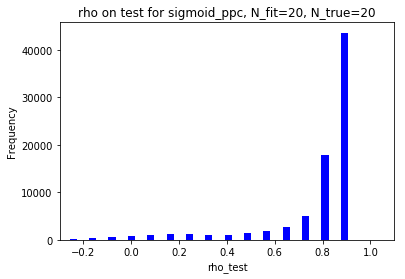

r2 var: 0.04799788229557947
r2 mean: 0.8364714517543104


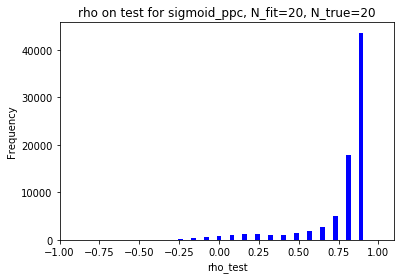

rho var: 0.04799788229557947
rho mean: 0.8364714517543104


In [25]:
# Visualize one specific plot

#########################################
k_scheme = 1
k_fit_N = 6
k_true_N = 6
##########################################

scheme = scheme_array[k_scheme]
fit_N = N_array[k_fit_N]
true_N = N_array[k_true_N]

#r2
metric_name = 'rho'
true_or_raw = 'true'
train_or_test = 'test'
exec("metric = %s_%s_%s_summary[k_scheme, k_fit_N, k_true_N]" % (metric_name, true_or_raw, train_or_test))

# We set the negative r2 to the same value
negative_center = -0.2
n_negative_values = 0
if metric_name.find('r2')!=-1:
    for k, metric_value in enumerate(metric):
        if metric_value <0:
            metric[k] = negative_center
            n_negative_values += 1

nbins = 20
width = 0.03
fig = plt.figure()
ax = fig.add_subplot(111) 
ax.hist(metric, bins=nbins, align='left', color='b', width=width)
ax.bar(negative_center, n_negative_values, color='r', width=2*width, align='center')
ax.set_title(metric_name+' on '+train_or_test+' for '+scheme+', N_fit='+str(fit_N)+', N_true='+str(true_N))
ax.set_xlabel('{}_{}'.format(metric_name, train_or_test))
ax.set_ylabel("Frequency")
ax.set_xlim([-0.3, 1.1])
plt.show()

print('r2 var: '+str(np.var(metric)))
print('r2 mean: '+str(np.mean(metric)))

# rho
metric_name = 'rho'
true_or_raw = 'true'
train_or_test = 'test'
exec("metric = %s_%s_%s_summary[k_scheme, k_fit_N, k_true_N]" % (metric_name, true_or_raw, train_or_test))

nbins = 20
width = 0.03
fig = plt.figure()
ax = fig.add_subplot(111) 
ax.hist(metric, bins=nbins, align='left', color='b', width=width)
ax.set_title(metric_name+' on '+train_or_test+' for '+scheme+', N_fit='+str(fit_N)+', N_true='+str(true_N))
ax.set_xlabel('{}_{}'.format(metric_name, train_or_test))
ax.set_ylabel("Frequency")
ax.set_xlim([-1, 1.1])
plt.show()

print('rho var: '+str(np.var(metric)))
print('rho mean: '+str(np.mean(metric)))

r2 on true test set, sigmoid_dpc
r2 on test set, sigmoid_dpc


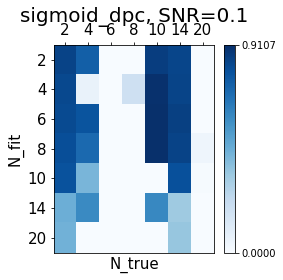

In [33]:
################################
k_scheme = 3
################################
n_fractions = 20
scheme = scheme_array[k_scheme]


metric_name = 'r2'
true_or_raw = 'true'
train_or_test = 'test'
exec("metric = %s_%s_%s_summary[k_scheme, k_fit_N, k_true_N]" % (metric_name, true_or_raw, train_or_test))

print(metric_name+' on '+true_or_raw+' '+train_or_test+' set, '+scheme)

# Visualize the entire confusion matrix
nbins = 20
width = 0.04

#fig, ax = plt.subplots(n_N, n_N, sharex='col', sharey='row', figsize = (10, 10))
#for k_fit_N in range(n_N):
#    for k_true_N in range(n_N):
#        exec("metric = %s_%s_%s_summary[k_scheme, k_fit_N, k_true_N]" % (metric_name, true_or_raw, train_or_test))
#        fit_N = N_array[k_fit_N]
#        true_N = N_array[k_true_N]
#        # We set the negative r2 to the same value
#        negative_center = -0.2
#        n_negative_values = 0
#        if metric_name.find('r2')!=-1:
#            for k, metric_value in enumerate(metric):
#                if metric_value <0:
#                    metric[k] = negative_center
#                    n_negative_values += 1
#
#        ax[k_fit_N, k_true_N].hist(metric, bins=nbins, align='left', color='b', width=width)
#        ax[k_fit_N, k_true_N].bar(negative_center, n_negative_values, color='r', width=2*width, align='center')
#        ax[k_fit_N, k_true_N].set_title('N_fit='+str(fit_N)+', N_true='+str(true_N))
#        ax[k_fit_N, k_true_N].set_xlabel('{}_{}'.format(metric_name, train_or_test))
#        ax[k_fit_N, k_true_N].set_ylabel("Frequency")
#        if metric_name.find('r2')!=-1:
#            ax[k_fit_N, k_true_N].set_xlim([-0.3, 1.1])
#        else:
#            ax[k_fit_N, k_true_N].set_xlim([-1, 1])
#        ax[k_fit_N, k_true_N].set_ylim([0, n_fractions*n_subjects*n_sessions/4])
#fig.tight_layout()
#plt.show()

# Plot the confusion matrix of the mean
column_labels = copy.deepcopy(N_array)
row_labels = copy.deepcopy(N_array)
print(metric_name+' on '+train_or_test+' set, '+scheme)

fig, ax = plt.subplots(figsize=(4,4))
fontsize = 15
exec("metric = copy.deepcopy(%s_%s_%s_summary[k_scheme, :, :, :])" % (metric_name, true_or_raw, train_or_test))
# We set the negative r2 to the same value
data = np.mean(metric, axis=2)
heatmap = ax.pcolor(data, cmap=plt.cm.Blues, vmin=0, vmax=np.max(data))

# put the major ticks at the middle of each cell
ax.set_xticks(np.arange(data.shape[1]) + 0.5, minor=False)
ax.set_yticks(np.arange(data.shape[0]) + 0.5, minor=False)

# want a more natural, table-like display
ax.invert_yaxis()
ax.xaxis.tick_top()

ax.set_xticklabels(column_labels, minor=False, fontsize=fontsize)
ax.set_yticklabels(row_labels, minor=False, fontsize=fontsize)
ax.set_ylabel('N_fit', fontsize=fontsize)
ax.set_xlabel('N_true', fontsize=fontsize)
plt.title(scheme+', SNR='+str(snr), y=1.08, fontsize=20)
cbar = fig.colorbar(heatmap, ticks=[0, np.max(data)])

fig.tight_layout()
plt.show()

### Find the optimal number of subjects to be generated

Plot the mean and variance of these distributions for different number of subjects

In [7]:
# Find the assymptotical value for n_fractions
n_subjects = 1000
n_subjects_array = np.linspace(1, n_subjects, num=int(n_subjects/5), endpoint=True).astype(int)

subject_r2_train_mean = np.zeros((n_schemes, n_N, n_N, len(n_subjects_array)))
subject_r2_train_var = np.zeros((n_schemes, n_N, n_N, len(n_subjects_array)))

subject_r2_test_mean = np.zeros((n_schemes, n_N, n_N, len(n_subjects_array)))
subject_r2_test_var = np.zeros((n_schemes, n_N, n_N, len(n_subjects_array)))

subject_rho_train_mean = np.zeros((n_schemes, n_N, n_N, len(n_subjects_array)))
subject_rho_train_var = np.zeros((n_schemes, n_N, n_N, len(n_subjects_array)))

subject_rho_test_mean = np.zeros((n_schemes, n_N, n_N, len(n_subjects_array)))
subject_rho_test_var = np.zeros((n_schemes, n_N, n_N, len(n_subjects_array)))

for k_n_subjects, n_subjects in enumerate(n_subjects_array):
    for k_scheme, k_fit_N, k_true_N in itertools.product(range(n_schemes), range(n_N), range(n_N)):            
        subject_r2_train_mean[k_scheme, k_fit_N, k_true_N, k_n_subjects] = \
            np.mean(r2_train[k_scheme, k_fit_N, k_true_N, :, :n_subjects, :].flatten())
        subject_r2_train_var[k_scheme, k_fit_N, k_true_N, k_n_subjects] = \
            np.var(r2_train[k_scheme, k_fit_N, k_true_N, :, :n_subjects, :].flatten())
                                      
        subject_r2_test_mean[k_scheme, k_fit_N, k_true_N, k_n_subjects] = \
            np.mean(r2_test[k_scheme, k_fit_N, k_true_N, :, :n_subjects, :].flatten())
        subject_r2_test_var[k_scheme, k_fit_N, k_true_N, k_n_subjects] = \
            np.var(r2_test[k_scheme, k_fit_N, k_true_N, :, :n_subjects, :].flatten())
                   
        subject_rho_train_mean[k_scheme, k_fit_N, k_true_N, k_n_subjects] = \
            np.mean(rho_train[k_scheme, k_fit_N, k_true_N, :, :n_subjects, :].flatten())
        subject_rho_train_var[k_scheme, k_fit_N, k_true_N, k_n_subjects] = \
            np.var(rho_train[k_scheme, k_fit_N, k_true_N, :, :n_subjects, :].flatten())

        subject_rho_test_mean[k_scheme, k_fit_N, k_true_N, k_n_subjects] = \
            np.mean(rho_test[k_scheme, k_fit_N, k_true_N, :, :n_subjects, :].flatten())
        subject_rho_test_var[k_scheme, k_fit_N, k_true_N, k_n_subjects] = \
            np.var(rho_test[k_scheme, k_fit_N, k_true_N, :, :n_subjects, :].flatten())

Scheme : sigmoid_ppc
true_N = 20
fit_N = 8



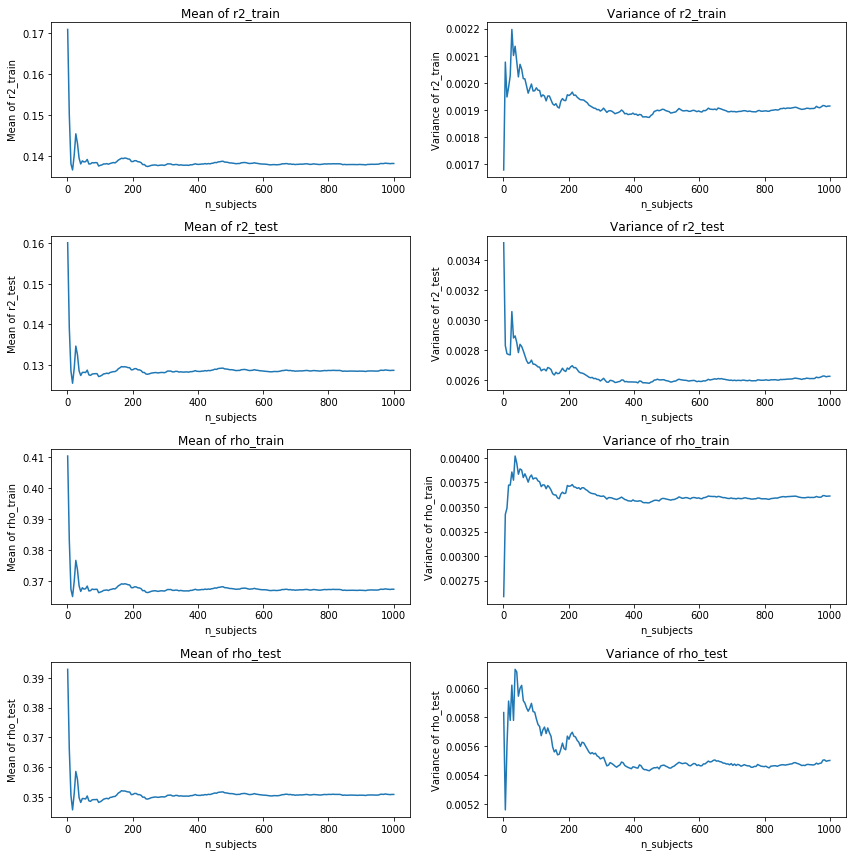

In [10]:
# Visualize the evolution of r2 according to the number of subjects
k_scheme = 1
k_fit_N = 3
k_true_N = 6

true_N = N_array[k_true_N]
fit_N = N_array[k_fit_N]

print('Scheme : '+scheme_array[k_scheme]+'\n'+'true_N = '+str(true_N)+'\nfit_N = '+str(fit_N)
      +'\n')

subject_r2_train_mean_to_plot = subject_r2_train_mean[k_scheme, k_fit_N, k_true_N, :]
subject_r2_train_var_to_plot = subject_r2_train_var[k_scheme, k_fit_N, k_true_N, :]

subject_r2_test_mean_to_plot = subject_r2_test_mean[k_scheme, k_fit_N, k_true_N, :]
subject_r2_test_var_to_plot = subject_r2_test_var[k_scheme, k_fit_N, k_true_N, :]

subject_rho_train_mean_to_plot = subject_rho_train_mean[k_scheme, k_fit_N, k_true_N, :]
subject_rho_train_var_to_plot = subject_rho_train_var[k_scheme, k_fit_N, k_true_N, :]

subject_rho_test_mean_to_plot = subject_rho_test_mean[k_scheme, k_fit_N, k_true_N, :]
subject_rho_test_var_to_plot = subject_rho_test_var[k_scheme, k_fit_N, k_true_N, :]


fig = plt.figure(figsize=(12, 12))
ax_r2_train_mean = fig.add_subplot(421)
ax_r2_train_mean.plot(n_subjects_array, subject_r2_train_mean_to_plot)
ax_r2_train_mean.set_xlabel('n_subjects')
ax_r2_train_mean.set_ylabel('Mean of r2_train')
ax_r2_train_mean.set_title('Mean of r2_train')

ax_r2_train_var = fig.add_subplot(422)
ax_r2_train_var.plot(n_subjects_array, subject_r2_train_var_to_plot)
ax_r2_train_var.set_xlabel('n_subjects')
ax_r2_train_var.set_ylabel('Variance of r2_train')
ax_r2_train_var.set_title('Variance of r2_train')

ax_r2_test_mean = fig.add_subplot(423)
ax_r2_test_mean.plot(n_subjects_array, subject_r2_test_mean_to_plot)
ax_r2_test_mean.set_xlabel('n_subjects')
ax_r2_test_mean.set_ylabel('Mean of r2_test')
ax_r2_test_mean.set_title('Mean of r2_test')

ax_r2_test_var = fig.add_subplot(424)
ax_r2_test_var.plot(n_subjects_array, subject_r2_test_var_to_plot)
ax_r2_test_var.set_xlabel('n_subjects')
ax_r2_test_var.set_ylabel('Variance of r2_test')
ax_r2_test_var.set_title('Variance of r2_test')

ax_rho_train_mean = fig.add_subplot(425)
ax_rho_train_mean.plot(n_subjects_array, subject_rho_train_mean_to_plot)
ax_rho_train_mean.set_xlabel('n_subjects')
ax_rho_train_mean.set_ylabel('Mean of rho_train')
ax_rho_train_mean.set_title('Mean of rho_train')

ax_rho_train_var = fig.add_subplot(426)
ax_rho_train_var.plot(n_subjects_array, subject_rho_train_var_to_plot)
ax_rho_train_var.set_xlabel('n_subjects')
ax_rho_train_var.set_ylabel('Variance of rho_train')
ax_rho_train_var.set_title('Variance of rho_train')

ax_rho_test_mean = fig.add_subplot(427)
ax_rho_test_mean.plot(n_subjects_array, subject_rho_test_mean_to_plot)
ax_rho_test_mean.set_xlabel('n_subjects')
ax_rho_test_mean.set_ylabel('Mean of rho_test')
ax_rho_test_mean.set_title('Mean of rho_test')

ax_rho_test_var = fig.add_subplot(428)
ax_rho_test_var.plot(n_subjects_array, subject_rho_test_var_to_plot)
ax_rho_test_var.set_xlabel('n_subjects')
ax_rho_test_var.set_ylabel('Variance of rho_test')
ax_rho_test_var.set_title('Variance of rho_test')
fig.tight_layout()

plt.show()

In [44]:
# Visualize worse r2

for k_scheme, k_fit_N, k_true_N, k_fraction, k_subject, k_session in itertools.product(range(n_schemes), 
                                                                            range(n_N), range(n_N), range(n_fractions), range(n_subjects), range(n_sessions)):
    if r2_true_test[k_scheme, k_fit_N, k_true_N, k_fraction, k_subject, k_session] < -100:
        print('k_scheme : '+str(k_scheme)+'\n'+'k_fit_N = '+str(k_fit_N)+'\nk_true_N = '+str(k_true_N)+'\nk_fraction = '+str(k_fraction)
          +'\n'+'Subject n°'+str(k_subject)+'\nLeft-out session : '+str(k_session))
        print(r2_true_test[k_scheme, k_fit_N, k_true_N, k_fraction, k_subject, k_session])
        print('---------------')

k_scheme : 0
k_fit_N = 0
k_true_N = 0
k_fraction19
Subject n°637
Left-out session : 1
-482.80176918763425
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 1
k_fraction3
Subject n°486
Left-out session : 1
-546.0702800761369
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 1
k_fraction6
Subject n°380
Left-out session : 1
-151.26526577228998
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 1
k_fraction11
Subject n°170
Left-out session : 0
-863.9582087292655
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 1
k_fraction14
Subject n°6
Left-out session : 2
-2585.018380919095
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 1
k_fraction14
Subject n°172
Left-out session : 1
-14460.796210609136
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 1
k_fraction14
Subject n°288
Left-out session : 3
-426.0899307788531
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 1
k_fraction14
Subject n°377
Left-out session : 3
-139.33074836354547
---------------
k_scheme : 0
k_fit_N = 0
k_true_

Left-out session : 2
-221.19003811117742
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 3
k_fraction3
Subject n°206
Left-out session : 2
-687.5180290604562
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 3
k_fraction3
Subject n°220
Left-out session : 2
-342.10611810802436
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 3
k_fraction3
Subject n°220
Left-out session : 3
-143096.64995252524
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 3
k_fraction3
Subject n°265
Left-out session : 2
-101.81163462744995
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 3
k_fraction3
Subject n°281
Left-out session : 1
-5361.146379217255
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 3
k_fraction3
Subject n°337
Left-out session : 3
-294.9464271983213
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 3
k_fraction3
Subject n°344
Left-out session : 1
-129.25125024292095
---------------
k_scheme : 0
k_fit_N = 0
k_true_N = 3
k_fraction3
Subject n°438
Left-out session : 3
-915.085339787

Left-out session : 1
-173.35937650829618
---------------
k_scheme : 0
k_fit_N = 1
k_true_N = 3
k_fraction2
Subject n°511
Left-out session : 1
-9999.025197279338
---------------
k_scheme : 0
k_fit_N = 1
k_true_N = 3
k_fraction2
Subject n°653
Left-out session : 2
-239.00349084091573
---------------
k_scheme : 0
k_fit_N = 1
k_true_N = 3
k_fraction2
Subject n°786
Left-out session : 2
-141.8142089951927
---------------
k_scheme : 0
k_fit_N = 1
k_true_N = 3
k_fraction3
Subject n°100
Left-out session : 3
-294.1714715032699
---------------
k_scheme : 0
k_fit_N = 1
k_true_N = 3
k_fraction3
Subject n°329
Left-out session : 0
-1213.1329509683555
---------------
k_scheme : 0
k_fit_N = 1
k_true_N = 3
k_fraction3
Subject n°391
Left-out session : 0
-227.39276332957166
---------------
k_scheme : 0
k_fit_N = 1
k_true_N = 3
k_fraction3
Subject n°448
Left-out session : 0
-1637.0311787607427
---------------
k_scheme : 0
k_fit_N = 1
k_true_N = 3
k_fraction3
Subject n°465
Left-out session : 0
-106.687602039

---------------
k_scheme : 0
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°247
Left-out session : 1
-891.7666328900573
---------------
k_scheme : 0
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°267
Left-out session : 1
-443.0757642498082
---------------
k_scheme : 0
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°361
Left-out session : 0
-1058.9253495355435
---------------
k_scheme : 0
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°416
Left-out session : 1
-141.64955415948342
---------------
k_scheme : 0
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°639
Left-out session : 0
-67946.18434343669
---------------
k_scheme : 0
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°639
Left-out session : 1
-11064.70875271383
---------------
k_scheme : 0
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°675
Left-out session : 1
-9787.418453522354
---------------
k_scheme : 0
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°998
Left-out session : 0
-1478.7282800860355
---------------
k_scheme : 0
k_fit_N 

-279.40441106047
---------------
k_scheme : 0
k_fit_N = 3
k_true_N = 4
k_fraction19
Subject n°795
Left-out session : 3
-46547.89807778013
---------------
k_scheme : 0
k_fit_N = 3
k_true_N = 4
k_fraction19
Subject n°876
Left-out session : 0
-167.7431628825985
---------------
k_scheme : 0
k_fit_N = 3
k_true_N = 4
k_fraction19
Subject n°919
Left-out session : 3
-102.77606200438564
---------------
k_scheme : 0
k_fit_N = 3
k_true_N = 4
k_fraction19
Subject n°978
Left-out session : 1
-630.3745152584145
---------------
k_scheme : 0
k_fit_N = 3
k_true_N = 5
k_fraction0
Subject n°771
Left-out session : 3
-250.87492080852272
---------------
k_scheme : 0
k_fit_N = 3
k_true_N = 5
k_fraction1
Subject n°150
Left-out session : 2
-172.94226871107094
---------------
k_scheme : 0
k_fit_N = 3
k_true_N = 5
k_fraction1
Subject n°182
Left-out session : 2
-133.31356683150085
---------------
k_scheme : 0
k_fit_N = 3
k_true_N = 5
k_fraction2
Subject n°398
Left-out session : 3
-106.30827987107192
--------------

-269.09161095042975
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 2
k_fraction9
Subject n°639
Left-out session : 0
-687.7778837969715
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 2
k_fraction9
Subject n°723
Left-out session : 3
-1422.0490391681171
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 2
k_fraction9
Subject n°783
Left-out session : 0
-1719.5530503253328
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 2
k_fraction9
Subject n°943
Left-out session : 2
-205.97741036522888
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 2
k_fraction10
Subject n°367
Left-out session : 3
-1818.2807584062384
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 2
k_fraction10
Subject n°386
Left-out session : 1
-129.82969120748697
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 2
k_fraction10
Subject n°427
Left-out session : 1
-115.5159376276438
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 2
k_fraction10
Subject n°430
Left-out session : 2
-9933.196652544919
-----------

---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 6
k_fraction15
Subject n°723
Left-out session : 3
-138.00239392014834
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 6
k_fraction16
Subject n°217
Left-out session : 0
-316.8023411640827
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 6
k_fraction16
Subject n°360
Left-out session : 2
-160.9012147482198
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 6
k_fraction16
Subject n°723
Left-out session : 3
-905.7339345489239
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 6
k_fraction17
Subject n°145
Left-out session : 1
-4961.478704195349
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 6
k_fraction17
Subject n°360
Left-out session : 2
-511.01977161842126
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 6
k_fraction17
Subject n°369
Left-out session : 1
-14974.868526455954
---------------
k_scheme : 0
k_fit_N = 4
k_true_N = 6
k_fraction17
Subject n°426
Left-out session : 3
-1870.7262595789612
---------------
k_scheme : 0

-666.6636744360515
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction8
Subject n°113
Left-out session : 3
-1520.5450937045061
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction8
Subject n°117
Left-out session : 2
-1255.4678292870944
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction8
Subject n°118
Left-out session : 0
-194.8845765714283
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction8
Subject n°124
Left-out session : 2
-160.64407505236207
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction8
Subject n°132
Left-out session : 0
-2449.2422532018422
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction8
Subject n°144
Left-out session : 2
-355.43554399458293
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction8
Subject n°145
Left-out session : 1
-102.42956033065481
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction8
Subject n°153
Left-out session : 2
-226.10350993263833
--------------

---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction15
Subject n°764
Left-out session : 3
-209.38644184355942
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction15
Subject n°768
Left-out session : 3
-120.56276028014894
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction15
Subject n°783
Left-out session : 0
-3486.5233891901994
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction15
Subject n°786
Left-out session : 2
-1809.071555481754
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction15
Subject n°799
Left-out session : 2
-100141.91309976549
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction15
Subject n°808
Left-out session : 2
-252.84972775000324
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction15
Subject n°813
Left-out session : 0
-146.79661137358528
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 0
k_fraction15
Subject n°834
Left-out session : 3
-102.62166440300552
---------------
k_scheme 

---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°130
Left-out session : 0
-256.63632080279297
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°132
Left-out session : 0
-280.12406214448004
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°141
Left-out session : 2
-111.74547723596056
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°144
Left-out session : 2
-124.23030633856874
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°145
Left-out session : 1
-275.9340034929879
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°154
Left-out session : 1
-256.13629420360326
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°168
Left-out session : 1
-1336.2627700092803
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°169
Left-out session : 2
-428.8581723453417
---------------
k_scheme : 0
k_fit

Left-out session : 2
-175.02051391081457
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction14
Subject n°574
Left-out session : 3
-1314.3236034431186
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction14
Subject n°580
Left-out session : 2
-1973.068482922678
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction14
Subject n°592
Left-out session : 1
-189.99857869780317
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction14
Subject n°603
Left-out session : 3
-544.263862071239
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction14
Subject n°618
Left-out session : 3
-139.41439457439276
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction14
Subject n°638
Left-out session : 1
-927.6391647882617
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction14
Subject n°640
Left-out session : 1
-948.6409048487349
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 1
k_fraction14
Subject n°644
Left-out session : 0
-264.656

Left-out session : 2
-838.5377317177627
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction4
Subject n°15
Left-out session : 1
-107.09136994414843
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction4
Subject n°52
Left-out session : 1
-12006.530109787498
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction4
Subject n°58
Left-out session : 0
-4850.133404174268
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction4
Subject n°70
Left-out session : 1
-105.17434255068378
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction4
Subject n°72
Left-out session : 2
-218.5401410293982
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction4
Subject n°73
Left-out session : 2
-351.2150036324596
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction4
Subject n°95
Left-out session : 1
-13673.6218525811
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction4
Subject n°110
Left-out session : 3
-2616.0843080781015
----

-114.48131315901078
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°717
Left-out session : 2
-165.1301043025211
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°744
Left-out session : 1
-1953.35181211981
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°747
Left-out session : 2
-257.32080692982294
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°758
Left-out session : 3
-314.0162208490127
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°760
Left-out session : 1
-1059508.9249672603
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°764
Left-out session : 3
-458.3862429843846
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°787
Left-out session : 0
-101.35452487383688
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°799
Left-out session : 2
-458.0655744158482
----------

---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction4
Subject n°145
Left-out session : 1
-389.7492784704043
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction4
Subject n°182
Left-out session : 2
-3489.0244189137493
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction4
Subject n°209
Left-out session : 0
-1568.9706680254212
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction4
Subject n°220
Left-out session : 2
-1072.5090209600864
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction4
Subject n°227
Left-out session : 2
-313.6911345796882
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction4
Subject n°229
Left-out session : 2
-613.003770682422
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction4
Subject n°249
Left-out session : 3
-283.42572247646865
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction4
Subject n°260
Left-out session : 0
-3387.206035433838
---------------
k_scheme : 0
k_fit_N 

---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction13
Subject n°229
Left-out session : 2
-623.2720808025597
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction13
Subject n°249
Left-out session : 0
-447.5287130056199
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction13
Subject n°249
Left-out session : 3
-150.35400368843528
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction13
Subject n°260
Left-out session : 0
-337.1308917344045
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction13
Subject n°268
Left-out session : 0
-227.86485065419322
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction13
Subject n°269
Left-out session : 2
-1058.336176649393
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction13
Subject n°283
Left-out session : 0
-268.28618304280474
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 3
k_fraction13
Subject n°287
Left-out session : 1
-65062.626401373724
---------------
k_scheme : 0

k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction3
Subject n°425
Left-out session : 1
-1238.5261227753483
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction3
Subject n°426
Left-out session : 3
-128.38644111350476
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction3
Subject n°439
Left-out session : 3
-180.4317465188517
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction3
Subject n°452
Left-out session : 0
-296.122375634781
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction3
Subject n°518
Left-out session : 2
-1577.663701054202
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction3
Subject n°532
Left-out session : 0
-937.189320906073
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction3
Subject n°569
Left-out session : 1
-946643.9493170729
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction3
Subject n°589
Left-out session : 1
-236.70383392659818
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k

---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction17
Subject n°211
Left-out session : 0
-103.47612681737988
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction17
Subject n°242
Left-out session : 2
-571.157404696598
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction17
Subject n°329
Left-out session : 1
-861.3763235360102
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction17
Subject n°337
Left-out session : 2
-109.802291674393
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction17
Subject n°340
Left-out session : 2
-183.0463365500122
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction17
Subject n°360
Left-out session : 2
-112.04255046600227
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction17
Subject n°367
Left-out session : 3
-140.9379824816396
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 4
k_fraction17
Subject n°387
Left-out session : 2
-64007.85221370271
---------------
k_scheme : 0
k_f

Left-out session : 3
-1589.6938767836145
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°393
Left-out session : 3
-2137.8799173073057
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°396
Left-out session : 1
-237.0784927480233
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°398
Left-out session : 3
-2299.176084809879
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°404
Left-out session : 1
-123.63361618767763
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°426
Left-out session : 2
-259.048779008377
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°430
Left-out session : 2
-444.53200946824234
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°523
Left-out session : 0
-14469.600329533303
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°527
Left-out session : 1
-138037.4773551

---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction19
Subject n°193
Left-out session : 0
-739.688485310889
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction19
Subject n°214
Left-out session : 1
-1002.0304723286214
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction19
Subject n°249
Left-out session : 0
-187.37642413902745
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction19
Subject n°272
Left-out session : 2
-186.4090453078097
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction19
Subject n°281
Left-out session : 0
-15541.927834404927
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction19
Subject n°282
Left-out session : 1
-247.69189004107776
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction19
Subject n°329
Left-out session : 1
-1021.9180126248549
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 5
k_fraction19
Subject n°345
Left-out session : 0
-5214.806835340682
---------------
k_scheme : 0

Left-out session : 0
-228.8076627882821
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 6
k_fraction8
Subject n°640
Left-out session : 1
-213.77767093633184
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 6
k_fraction8
Subject n°642
Left-out session : 3
-761.058719205972
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 6
k_fraction8
Subject n°694
Left-out session : 2
-1641.7371025801317
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 6
k_fraction8
Subject n°723
Left-out session : 3
-195.32744635004914
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 6
k_fraction8
Subject n°747
Left-out session : 2
-2558.973470753727
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 6
k_fraction8
Subject n°749
Left-out session : 1
-3614620.853074132
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 6
k_fraction8
Subject n°771
Left-out session : 3
-355.21184781114226
---------------
k_scheme : 0
k_fit_N = 5
k_true_N = 6
k_fraction8
Subject n°782
Left-out session : 3
-4463.6318240911

k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction0
Subject n°77
Left-out session : 1
-136.2109475427339
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction0
Subject n°78
Left-out session : 0
-101.90192997505318
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction0
Subject n°79
Left-out session : 3
-342.36386382136817
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction0
Subject n°84
Left-out session : 2
-294.93211635460256
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction0
Subject n°84
Left-out session : 3
-103.34836301134162
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction0
Subject n°89
Left-out session : 1
-163593.65790546432
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction0
Subject n°90
Left-out session : 0
-2658.7028822203156
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction0
Subject n°92
Left-out session : 2
-6093.965481622302
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fr

Left-out session : 0
-692.736681533145
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction1
Subject n°854
Left-out session : 3
-898.1047461252201
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction1
Subject n°858
Left-out session : 2
-2240.2686275729407
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction1
Subject n°862
Left-out session : 1
-1557.8719028467478
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction1
Subject n°864
Left-out session : 0
-243.35100081099782
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction1
Subject n°864
Left-out session : 3
-106.04763859102302
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction1
Subject n°865
Left-out session : 2
-2437.909414215752
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction1
Subject n°871
Left-out session : 0
-2075.017719401629
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction1
Subject n°873
Left-out session : 1
-771.20302804279

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°951
Left-out session : 1
-112.12253407662246
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°960
Left-out session : 2
-258.2842511819415
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°966
Left-out session : 3
-139.7011345197576
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°967
Left-out session : 3
-469.9967115527435
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°968
Left-out session : 2
-127.31376631996332
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°969
Left-out session : 1
-7704.832495037431
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°971
Left-out session : 1
-111.84903976835442
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°975
Left-out session : 3
-1193.3755355108424
---------------
k_scheme : 0
k_fit_N

Left-out session : 0
-1774.33229098626
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction5
Subject n°490
Left-out session : 1
-479.495661132976
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction5
Subject n°491
Left-out session : 0
-177.79176818604537
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction5
Subject n°492
Left-out session : 1
-108.26593088456731
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction5
Subject n°494
Left-out session : 0
-405.2635700835243
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction5
Subject n°495
Left-out session : 3
-118.14602914355693
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction5
Subject n°496
Left-out session : 0
-102.3140618339309
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction5
Subject n°496
Left-out session : 1
-109.4262478574258
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction5
Subject n°498
Left-out session : 0
-154.6969173969367

k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction7
Subject n°642
Left-out session : 3
-126572.24581545587
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction7
Subject n°647
Left-out session : 0
-176.3937803945799
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction7
Subject n°647
Left-out session : 1
-7834.485508231998
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction7
Subject n°647
Left-out session : 2
-141.05945797996998
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction7
Subject n°649
Left-out session : 0
-230.4875501530397
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction7
Subject n°650
Left-out session : 1
-134.36590890009333
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction7
Subject n°653
Left-out session : 2
-1014.0968188969983
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction7
Subject n°654
Left-out session : 2
-175.34265769312
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0


---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°58
Left-out session : 2
-226.73575086737327
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°66
Left-out session : 0
-329.22846326035454
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°67
Left-out session : 1
-156.3546976279236
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°67
Left-out session : 3
-388.30377911147485
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°69
Left-out session : 1
-327.8387998826352
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°70
Left-out session : 1
-168.9231117443797
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°73
Left-out session : 2
-627026.0688317796
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°74
Left-out session : 0
-177.1502510628325
---------------
k_scheme : 0
k_fit_N = 6
k_tr

-156.05383835508195
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction10
Subject n°832
Left-out session : 3
-988.8541018193436
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction10
Subject n°833
Left-out session : 2
-621.2484702758012
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction10
Subject n°837
Left-out session : 1
-469.94587529271126
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction10
Subject n°840
Left-out session : 0
-131.72550831870663
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction10
Subject n°841
Left-out session : 1
-1141268.82758382
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction10
Subject n°845
Left-out session : 0
-121.9729671697452
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction10
Subject n°847
Left-out session : 3
-114.6620242727355
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction10
Subject n°851
Left-out session : 0
-127.2968480127416
-----------

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction12
Subject n°647
Left-out session : 1
-55783670.42451793
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction12
Subject n°647
Left-out session : 2
-145.16998198859764
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction12
Subject n°649
Left-out session : 0
-264.9450970495865
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction12
Subject n°650
Left-out session : 1
-221.36569050437512
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction12
Subject n°653
Left-out session : 2
-331.86773320849653
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction12
Subject n°654
Left-out session : 2
-29693.621685504248
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction12
Subject n°660
Left-out session : 0
-321.03508646119536
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction12
Subject n°670
Left-out session : 0
-312.3779664281055
---------------
k_scheme : 

-110.08807815414984
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction14
Subject n°564
Left-out session : 3
-678.0199291661714
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction14
Subject n°567
Left-out session : 2
-368.6363702067258
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction14
Subject n°569
Left-out session : 1
-213.29318813055406
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction14
Subject n°571
Left-out session : 0
-159.43715056802918
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction14
Subject n°571
Left-out session : 3
-357.71051716999784
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction14
Subject n°572
Left-out session : 0
-200.30323721740817
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction14
Subject n°573
Left-out session : 2
-642.585657497811
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction14
Subject n°574
Left-out session : 3
-282.12574722964473
--------

k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°402
Left-out session : 2
-596.8346207804939
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°403
Left-out session : 3
-65896.98421464165
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°404
Left-out session : 1
-674.4026330237251
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°410
Left-out session : 1
-241.07669821459598
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°411
Left-out session : 1
-140.94825407788986
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°415
Left-out session : 0
-729.0467894796495
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°417
Left-out session : 3
-883.8417402926515
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°419
Left-out session : 1
-1573.0672165041606
---------------
k_scheme : 0
k_fit_N = 6
k_tr

-221.03594208166896
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction18
Subject n°70
Left-out session : 1
-186.66160638892515
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction18
Subject n°73
Left-out session : 2
-419.5161902790472
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction18
Subject n°74
Left-out session : 0
-136.93484857004754
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction18
Subject n°75
Left-out session : 0
-292.8518578678366
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction18
Subject n°76
Left-out session : 0
-228.8142018537489
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction18
Subject n°77
Left-out session : 1
-583.5251912505578
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction18
Subject n°78
Left-out session : 0
-233.23113439336353
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction18
Subject n°81
Left-out session : 1
-1731.4741068902624
---------------


Left-out session : 1
-1325.5457077903393
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°991
Left-out session : 3
-103.24037295495876
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°997
Left-out session : 0
-171.55626150410717
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°998
Left-out session : 1
-2063.2181595884967
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°998
Left-out session : 2
-2047.1121355366968
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction0
Subject n°1
Left-out session : 1
-655.3382387181779
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction0
Subject n°2
Left-out session : 3
-1021.7181823773911
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction0
Subject n°3
Left-out session : 0
-138.69010649648064
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction0
Subject n°3
Left-out session : 1
-184.59506999772

k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction1
Subject n°538
Left-out session : 2
-122706.62496754402
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction1
Subject n°545
Left-out session : 2
-197.9888986543842
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction1
Subject n°556
Left-out session : 2
-332.0725247269751
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction1
Subject n°558
Left-out session : 2
-329.7068572617017
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction1
Subject n°560
Left-out session : 3
-157.65917875254712
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction1
Subject n°563
Left-out session : 3
-284.4295352159657
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction1
Subject n°567
Left-out session : 0
-570.893061160916
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction1
Subject n°569
Left-out session : 1
-530.0118380737414
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k

-282.49084949676893
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°252
Left-out session : 2
-368.27705453600225
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°254
Left-out session : 1
-2671.273504605469
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°255
Left-out session : 3
-1092.5297736339553
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°257
Left-out session : 1
-101.71148981073627
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°261
Left-out session : 1
-1121.5088364815122
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°264
Left-out session : 2
-246.29425003729637
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°265
Left-out session : 2
-171.27761305427072
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°267
Left-out session : 2
-304.13493759595633
-------------

k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction5
Subject n°188
Left-out session : 0
-285.14536442679025
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction5
Subject n°188
Left-out session : 1
-1150265.059284072
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction5
Subject n°193
Left-out session : 3
-3629.020325236925
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction5
Subject n°195
Left-out session : 3
-1661.0226768941677
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction5
Subject n°199
Left-out session : 2
-100.93994342098637
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction5
Subject n°200
Left-out session : 3
-107.07031628862993
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction5
Subject n°205
Left-out session : 1
-2271.6271546330518
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction5
Subject n°211
Left-out session : 0
-268.0146182756416
---------------
k_scheme : 0
k_fit_N = 6
k_true_N =

-681.5320606442966
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction7
Subject n°50
Left-out session : 3
-11833.226149349512
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction7
Subject n°51
Left-out session : 2
-126.0790965491767
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction7
Subject n°52
Left-out session : 1
-53244.56263400522
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction7
Subject n°53
Left-out session : 1
-4511.6942677134275
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction7
Subject n°55
Left-out session : 1
-3579.924333553159
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction7
Subject n°58
Left-out session : 0
-118.71895941006372
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction7
Subject n°61
Left-out session : 2
-8499.327555923508
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction7
Subject n°64
Left-out session : 1
-9935.864743914559
---------------
k_scheme :

k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°908
Left-out session : 0
-1031.3561673428594
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°908
Left-out session : 3
-3044.2040980571783
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°910
Left-out session : 3
-282.85285001278504
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°911
Left-out session : 3
-3355.8192274132252
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°917
Left-out session : 0
-1211.283622712206
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°920
Left-out session : 0
-777562.9438130466
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°921
Left-out session : 3
-5274.700269898476
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°923
Left-out session : 0
-444.91096255040577
---------------
k_scheme : 0
k_fit_N = 6
k_true_N =

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°624
Left-out session : 2
-201.66783787084128
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°625
Left-out session : 2
-118.92254211609311
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°628
Left-out session : 3
-4102.567806013145
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°630
Left-out session : 1
-2309.3382252400575
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°631
Left-out session : 3
-270.17671014628684
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°634
Left-out session : 2
-1262.6970755234152
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°636
Left-out session : 3
-904.8472592640084
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°637
Left-out session : 1
-127.5164491293281
---------------
k_scheme : 

Left-out session : 3
-183.35964672384418
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction12
Subject n°699
Left-out session : 3
-2676.8059247496108
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction12
Subject n°702
Left-out session : 3
-115.79996054638973
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction12
Subject n°704
Left-out session : 0
-107.40190552277984
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction12
Subject n°705
Left-out session : 2
-154.99026506222094
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction12
Subject n°705
Left-out session : 3
-10931.898805425808
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction12
Subject n°706
Left-out session : 3
-1295.2528667987867
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction12
Subject n°707
Left-out session : 0
-133.90554753402168
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction12
Subject n°711
Left-out session : 0
-35

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction14
Subject n°97
Left-out session : 3
-451.4423562066349
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction14
Subject n°100
Left-out session : 0
-571.9645297033978
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction14
Subject n°100
Left-out session : 1
-104.19977141255778
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction14
Subject n°102
Left-out session : 0
-486.1344823461249
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction14
Subject n°102
Left-out session : 3
-289.80693235007703
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction14
Subject n°104
Left-out session : 2
-3718.3026867680296
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction14
Subject n°107
Left-out session : 2
-221093.74089809105
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction14
Subject n°108
Left-out session : 0
-1797.3938260039479
---------------
k_scheme : 0

Left-out session : 0
-228.79294926674527
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction15
Subject n°665
Left-out session : 2
-113.35799773446408
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction15
Subject n°668
Left-out session : 3
-292.5108543730422
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction15
Subject n°670
Left-out session : 0
-1985.3750327257176
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction15
Subject n°673
Left-out session : 0
-695.1152858296499
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction15
Subject n°676
Left-out session : 0
-135.2569556509128
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction15
Subject n°677
Left-out session : 3
-190.41757465072956
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction15
Subject n°679
Left-out session : 3
-167.29122131555928
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction15
Subject n°682
Left-out session : 1
-3901.

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction17
Subject n°762
Left-out session : 3
-265.5094279786133
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction17
Subject n°763
Left-out session : 0
-335.0217410667355
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction17
Subject n°764
Left-out session : 1
-65191.69354347846
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction17
Subject n°764
Left-out session : 3
-140.80630425848767
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction17
Subject n°765
Left-out session : 0
-1219.3713280614804
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction17
Subject n°766
Left-out session : 3
-142.52298151869812
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction17
Subject n°767
Left-out session : 2
-134.8634210607746
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction17
Subject n°770
Left-out session : 1
-133.73619786959634
---------------
k_scheme : 0

Left-out session : 2
-961.543635691868
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction19
Subject n°361
Left-out session : 3
-2140.0979897246434
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction19
Subject n°363
Left-out session : 3
-42878.063609680736
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction19
Subject n°369
Left-out session : 1
-186.6534437810468
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction19
Subject n°370
Left-out session : 3
-374.511732642352
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction19
Subject n°373
Left-out session : 1
-61728.54667008125
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction19
Subject n°374
Left-out session : 3
-4693.2184474358755
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction19
Subject n°376
Left-out session : 1
-110.32786602136038
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 1
k_fraction19
Subject n°380
Left-out session : 3
-489.6222

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction1
Subject n°385
Left-out session : 1
-1794.9054963225312
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction1
Subject n°386
Left-out session : 2
-642.222621931791
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction1
Subject n°389
Left-out session : 3
-2233.1325673159827
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction1
Subject n°390
Left-out session : 2
-103.40846898641206
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction1
Subject n°396
Left-out session : 1
-324.08817822725064
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction1
Subject n°396
Left-out session : 3
-667.6446844478771
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction1
Subject n°398
Left-out session : 1
-198.82793711987975
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction1
Subject n°400
Left-out session : 2
-170.28667059801037
---------------
k_scheme : 0
k_fit_

Left-out session : 1
-1200.7878689261242
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction3
Subject n°294
Left-out session : 2
-2625.16399125725
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction3
Subject n°295
Left-out session : 3
-136.35688198928142
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction3
Subject n°300
Left-out session : 3
-119.81679781151381
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction3
Subject n°301
Left-out session : 0
-351.412476780297
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction3
Subject n°304
Left-out session : 0
-100.9589371397184
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction3
Subject n°308
Left-out session : 2
-329.86000413950535
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction3
Subject n°310
Left-out session : 3
-262.7401596578292
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction3
Subject n°311
Left-out session : 2
-6644.00931031013

-280.25314681386755
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction5
Subject n°345
Left-out session : 3
-5934.963136078328
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction5
Subject n°349
Left-out session : 2
-292.9568215053157
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction5
Subject n°350
Left-out session : 0
-292.48620252435353
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction5
Subject n°353
Left-out session : 3
-307.79032284341105
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction5
Subject n°354
Left-out session : 0
-308.46892485301635
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction5
Subject n°354
Left-out session : 2
-72006.04016971872
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction5
Subject n°356
Left-out session : 3
-151.32295065547038
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction5
Subject n°357
Left-out session : 0
-1465.744009530063
---------------


-257.2592592064377
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°558
Left-out session : 2
-469.3537996724837
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°563
Left-out session : 3
-567.7244486746109
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°567
Left-out session : 0
-165.4349569708926
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°567
Left-out session : 1
-237.01813268664648
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°567
Left-out session : 2
-1192.5680698639537
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°569
Left-out session : 1
-186.77328965131105
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°570
Left-out session : 3
-976.8098336975027
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°573
Left-out session : 2
-257.37795011346475
---------------
k

-119.76790642837615
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction9
Subject n°443
Left-out session : 1
-3030.7537526837627
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction9
Subject n°446
Left-out session : 3
-282.9415766678823
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction9
Subject n°447
Left-out session : 3
-498.8764579045362
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction9
Subject n°448
Left-out session : 0
-441.38067624101336
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction9
Subject n°449
Left-out session : 0
-255.54858879545748
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction9
Subject n°451
Left-out session : 1
-123.95989445387687
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction9
Subject n°451
Left-out session : 3
-308.70813199117356
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction9
Subject n°452
Left-out session : 0
-127.76923921053637
--------------

k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction11
Subject n°595
Left-out session : 0
-243.38189333879873
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction11
Subject n°597
Left-out session : 0
-217.00464529803483
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction11
Subject n°600
Left-out session : 0
-5181.832442371205
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction11
Subject n°601
Left-out session : 0
-2825.0458864069674
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction11
Subject n°602
Left-out session : 2
-4027.3482114657963
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction11
Subject n°603
Left-out session : 3
-550.485215801347
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction11
Subject n°605
Left-out session : 3
-14549.388344532037
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction11
Subject n°609
Left-out session : 2
-1111.0163814165987
---------------
k_scheme : 0
k_fit_N = 6
k_

k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction13
Subject n°462
Left-out session : 0
-130.96511054274987
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction13
Subject n°462
Left-out session : 2
-6733.488091063681
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction13
Subject n°464
Left-out session : 3
-266.4226489931988
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction13
Subject n°468
Left-out session : 0
-1540.3358455054047
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction13
Subject n°470
Left-out session : 1
-387.9822172501894
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction13
Subject n°474
Left-out session : 2
-4474.152277936157
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction13
Subject n°475
Left-out session : 2
-1578705.216681592
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction13
Subject n°477
Left-out session : 2
-222.72183164336212
---------------
k_scheme : 0
k_fit_N = 6
k_tr

-2512.921829879773
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction15
Subject n°453
Left-out session : 3
-3456.6217192957974
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction15
Subject n°455
Left-out session : 1
-187.19947153248648
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction15
Subject n°455
Left-out session : 2
-549.1192199135436
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction15
Subject n°457
Left-out session : 3
-2216.3262127584685
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction15
Subject n°458
Left-out session : 2
-214.17453346860484
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction15
Subject n°459
Left-out session : 3
-341.22679805773936
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction15
Subject n°462
Left-out session : 0
-166.93168735950889
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction15
Subject n°464
Left-out session : 3
-109.92379193887119
------

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction17
Subject n°541
Left-out session : 0
-3788.0021171282624
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction17
Subject n°544
Left-out session : 3
-212.06463396029287
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction17
Subject n°545
Left-out session : 2
-172.2791848549926
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction17
Subject n°553
Left-out session : 2
-136.20838190705095
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction17
Subject n°554
Left-out session : 2
-323.2831612149195
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction17
Subject n°555
Left-out session : 1
-854.3553293071243
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction17
Subject n°556
Left-out session : 2
-364.20000211377715
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction17
Subject n°558
Left-out session : 1
-462.5112502401543
---------------
k_scheme : 0

Left-out session : 1
-32300.101950620243
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction19
Subject n°398
Left-out session : 3
-100.93677909295582
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction19
Subject n°400
Left-out session : 2
-446.93916873797787
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction19
Subject n°403
Left-out session : 0
-428.4682676006575
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction19
Subject n°409
Left-out session : 3
-134.5893262978348
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction19
Subject n°410
Left-out session : 1
-155.12673717598918
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction19
Subject n°413
Left-out session : 1
-115.45814518484266
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction19
Subject n°416
Left-out session : 3
-177.03967032884026
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 2
k_fraction19
Subject n°420
Left-out session : 1
-1917

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction1
Subject n°424
Left-out session : 1
-221.89351623608013
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction1
Subject n°427
Left-out session : 1
-244.07982420287823
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction1
Subject n°429
Left-out session : 3
-1162.6737458882412
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction1
Subject n°430
Left-out session : 2
-288.71596154762204
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction1
Subject n°431
Left-out session : 2
-340.15183506619013
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction1
Subject n°435
Left-out session : 3
-200.5697903079121
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction1
Subject n°441
Left-out session : 1
-2544.897903493093
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction1
Subject n°447
Left-out session : 3
-301.4792972957035
---------------
k_scheme : 0
k_fit_

-461.5911524985489
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction3
Subject n°477
Left-out session : 2
-463.3508586935417
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction3
Subject n°483
Left-out session : 2
-276036.90394825966
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction3
Subject n°487
Left-out session : 3
-164.82803428679884
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction3
Subject n°489
Left-out session : 3
-157.56866908800288
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction3
Subject n°490
Left-out session : 1
-81666.80608896441
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction3
Subject n°496
Left-out session : 1
-137.11717491328892
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction3
Subject n°497
Left-out session : 3
-260.3627257282846
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction3
Subject n°502
Left-out session : 0
-151.17553260047936
---------------


---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction5
Subject n°747
Left-out session : 2
-873.1949588391147
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction5
Subject n°748
Left-out session : 2
-237.4057278342124
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction5
Subject n°754
Left-out session : 1
-254.47384849861854
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction5
Subject n°755
Left-out session : 3
-218.4050997746075
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction5
Subject n°757
Left-out session : 1
-9119.132330234519
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction5
Subject n°757
Left-out session : 2
-5702.566427745186
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction5
Subject n°762
Left-out session : 2
-282.36850200184205
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction5
Subject n°762
Left-out session : 3
-3746.8386345861986
---------------
k_scheme : 0
k_fit_N 

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°889
Left-out session : 3
-104.2217012674808
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°892
Left-out session : 0
-188.99043636564804
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°894
Left-out session : 0
-393.6517472973321
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°896
Left-out session : 2
-403.37735646143136
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°900
Left-out session : 1
-1107.9208505234426
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°906
Left-out session : 0
-400.9186807446292
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°919
Left-out session : 3
-38436.06424649713
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°924
Left-out session : 0
-106.37246318926567
---------------
k_scheme : 0
k_fit_N

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction10
Subject n°102
Left-out session : 3
-173.54942175789174
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction10
Subject n°104
Left-out session : 2
-103.88581612851654
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction10
Subject n°104
Left-out session : 3
-131.29392372349332
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction10
Subject n°107
Left-out session : 2
-151.58071713530964
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction10
Subject n°108
Left-out session : 0
-5331.794087149877
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction10
Subject n°112
Left-out session : 0
-191.53310820930344
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction10
Subject n°123
Left-out session : 0
-264.3257147049857
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction10
Subject n°124
Left-out session : 1
-143.8030404605318
---------------
k_scheme : 

-430.6330004373038
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction11
Subject n°780
Left-out session : 2
-150.35046401405268
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction11
Subject n°786
Left-out session : 2
-266.8612537091906
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction11
Subject n°786
Left-out session : 3
-1563.5121513662696
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction11
Subject n°792
Left-out session : 0
-162.26302355723467
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction11
Subject n°794
Left-out session : 0
-1672.1135230592176
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction11
Subject n°796
Left-out session : 2
-1837.8442437934991
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction11
Subject n°802
Left-out session : 0
-573.4208405310193
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction11
Subject n°803
Left-out session : 0
-559.129463865313
---------

Left-out session : 2
-119.31140631827117
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction13
Subject n°345
Left-out session : 0
-173.31103531390798
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction13
Subject n°348
Left-out session : 3
-229.52146439361928
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction13
Subject n°349
Left-out session : 2
-475.4639227966017
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction13
Subject n°353
Left-out session : 3
-333.6053344281514
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction13
Subject n°354
Left-out session : 0
-623.1151360463389
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction13
Subject n°356
Left-out session : 3
-542.6600605619769
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction13
Subject n°357
Left-out session : 0
-20737.288653288084
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction13
Subject n°358
Left-out session : 0
-40655.

Left-out session : 3
-247.44805882884972
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction15
Subject n°363
Left-out session : 3
-730.1717996928761
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction15
Subject n°365
Left-out session : 1
-3441.404759325966
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction15
Subject n°367
Left-out session : 3
-186.07552176338393
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction15
Subject n°373
Left-out session : 3
-106.06938095432255
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction15
Subject n°376
Left-out session : 2
-589.0974076419523
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction15
Subject n°379
Left-out session : 2
-692.5529418788232
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction15
Subject n°383
Left-out session : 2
-207.30177039835178
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction15
Subject n°383
Left-out session : 3
-224.56

-3981.612907646069
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°701
Left-out session : 3
-2177.8909239498757
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°702
Left-out session : 3
-674.7954510191199
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°707
Left-out session : 0
-458.0813971735388
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°711
Left-out session : 0
-5953.51571110641
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°715
Left-out session : 3
-114388.87988057622
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°716
Left-out session : 0
-3664.652575418133
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°716
Left-out session : 1
-2588.6220205094487
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°723
Left-out session : 2
-301.23469941517027
----------

-169.83083677777023
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction19
Subject n°537
Left-out session : 0
-2674.595264992221
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction19
Subject n°538
Left-out session : 2
-205.85599812806987
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction19
Subject n°539
Left-out session : 3
-108.60855790990998
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction19
Subject n°540
Left-out session : 2
-2016.7723139566003
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction19
Subject n°540
Left-out session : 3
-10345.583942088984
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction19
Subject n°541
Left-out session : 0
-233.76127886113863
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction19
Subject n°543
Left-out session : 3
-216.0002307197063
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 3
k_fraction19
Subject n°551
Left-out session : 0
-490.0546596610753
-------

-108.15038900338065
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°313
Left-out session : 2
-1268.9663807784898
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°317
Left-out session : 2
-750.7767735833195
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°318
Left-out session : 0
-14034.852511184818
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°319
Left-out session : 3
-407.06510627484346
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°329
Left-out session : 2
-966.7691422271897
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°332
Left-out session : 2
-150.8733243931052
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°336
Left-out session : 1
-31658.919784600257
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°336
Left-out session : 2
-111.09016736665433
---------------

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction3
Subject n°532
Left-out session : 1
-69886.93869386711
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction3
Subject n°534
Left-out session : 2
-130.0649617426173
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction3
Subject n°534
Left-out session : 3
-301.78942723232825
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction3
Subject n°536
Left-out session : 0
-2096.0351808321216
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction3
Subject n°544
Left-out session : 3
-676.5457448115
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction3
Subject n°548
Left-out session : 0
-3017.035884846968
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction3
Subject n°550
Left-out session : 0
-111.33624688237542
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction3
Subject n°555
Left-out session : 1
-2852.9833553618073
---------------
k_scheme : 0
k_fit_N = 

k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction5
Subject n°332
Left-out session : 2
-104.24927503936254
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction5
Subject n°333
Left-out session : 1
-1001.0382624399389
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction5
Subject n°334
Left-out session : 2
-2032.6258917131502
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction5
Subject n°337
Left-out session : 1
-372.8702752252323
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction5
Subject n°337
Left-out session : 2
-440.0004921275213
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction5
Subject n°340
Left-out session : 1
-988.6234076214641
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction5
Subject n°340
Left-out session : 2
-205.2852309003732
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction5
Subject n°345
Left-out session : 3
-19657.173523148
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k

Left-out session : 0
-1751.2682637642945
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°218
Left-out session : 1
-128.48581802894506
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°221
Left-out session : 0
-1059.4076478979239
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°223
Left-out session : 3
-610.7954359062387
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°224
Left-out session : 0
-474.2372416089338
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°226
Left-out session : 0
-9415.867596204364
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°229
Left-out session : 2
-255.79758323857118
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°232
Left-out session : 2
-323.44687195312395
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°237
Left-out session : 1
-134.739316144

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction9
Subject n°193
Left-out session : 3
-201.12254235124007
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction9
Subject n°195
Left-out session : 3
-519.6500775311157
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction9
Subject n°197
Left-out session : 3
-101.65224843061434
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction9
Subject n°203
Left-out session : 2
-152.72748317084603
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction9
Subject n°211
Left-out session : 0
-3723.4434225062782
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction9
Subject n°215
Left-out session : 0
-1286.942005191837
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction9
Subject n°216
Left-out session : 3
-104.78616078867056
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction9
Subject n°217
Left-out session : 3
-6169.505898463694
---------------
k_scheme : 0
k_fit_

-922.8421556338922
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction11
Subject n°336
Left-out session : 2
-292.855323027942
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction11
Subject n°337
Left-out session : 1
-600.983721852658
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction11
Subject n°337
Left-out session : 2
-485.55719898126557
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction11
Subject n°339
Left-out session : 0
-595.7512752027677
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction11
Subject n°340
Left-out session : 1
-223.23405034960783
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction11
Subject n°340
Left-out session : 2
-243.37605209218856
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction11
Subject n°345
Left-out session : 0
-581.9700257326556
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction11
Subject n°346
Left-out session : 1
-234.56409688954318
-----------

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction13
Subject n°859
Left-out session : 2
-387.1587776106013
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction13
Subject n°861
Left-out session : 0
-21472.747202108083
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction13
Subject n°863
Left-out session : 1
-1350.8215801197985
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction13
Subject n°865
Left-out session : 2
-202.47786009691814
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction13
Subject n°866
Left-out session : 0
-527.1055604323241
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction13
Subject n°871
Left-out session : 0
-579.7727670609352
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction13
Subject n°872
Left-out session : 2
-230.88589220178673
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction13
Subject n°873
Left-out session : 1
-442.4381046766223
---------------
k_scheme : 0

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction15
Subject n°647
Left-out session : 0
-10945.099519409876
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction15
Subject n°648
Left-out session : 1
-1222.2551984567415
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction15
Subject n°653
Left-out session : 2
-183.23415813997048
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction15
Subject n°654
Left-out session : 2
-295.04559498156857
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction15
Subject n°656
Left-out session : 3
-6405.345861495283
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction15
Subject n°658
Left-out session : 0
-963.2227583954593
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction15
Subject n°659
Left-out session : 3
-109.27470771959975
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction15
Subject n°660
Left-out session : 0
-215.02714885782743
---------------
k_scheme :

Left-out session : 1
-431.5978739542201
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction17
Subject n°689
Left-out session : 0
-107.64244024662217
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction17
Subject n°690
Left-out session : 1
-1937.9796307493393
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction17
Subject n°694
Left-out session : 2
-10989.921246754939
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction17
Subject n°707
Left-out session : 0
-611.83468214229
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction17
Subject n°713
Left-out session : 0
-131.384272741586
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction17
Subject n°716
Left-out session : 1
-596.4043662154291
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction17
Subject n°720
Left-out session : 0
-32610.4800518149
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction17
Subject n°720
Left-out session : 2
-4881.668126

k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°723
Left-out session : 3
-2662.5389192846824
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°726
Left-out session : 1
-353.58371579693187
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°727
Left-out session : 2
-2597.8349688868693
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°732
Left-out session : 1
-100.14832621720025
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°734
Left-out session : 3
-104.87105435465561
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°735
Left-out session : 0
-4025.2407886544916
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°735
Left-out session : 1
-273.06157232809926
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°736
Left-out session : 3
-246220.85326101282
---------------
k_scheme : 0
k_fit_N = 6

-113.92958965443043
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction1
Subject n°869
Left-out session : 2
-3384.1291014733583
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction1
Subject n°870
Left-out session : 1
-138.8607718306171
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction1
Subject n°872
Left-out session : 2
-270.4741795989401
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction1
Subject n°882
Left-out session : 0
-342.9607697631338
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction1
Subject n°886
Left-out session : 2
-2991.5979221410817
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction1
Subject n°889
Left-out session : 1
-113.4483381575962
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction1
Subject n°892
Left-out session : 0
-624.2693359397131
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction1
Subject n°894
Left-out session : 0
-123.0659974747211
---------------
k_

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction3
Subject n°980
Left-out session : 1
-1810.6988238241452
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction3
Subject n°991
Left-out session : 2
-135.52125657177208
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction3
Subject n°991
Left-out session : 3
-209.33900138286586
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction3
Subject n°998
Left-out session : 0
-582.3863370929728
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction4
Subject n°4
Left-out session : 0
-514.3792860803406
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction4
Subject n°8
Left-out session : 1
-433.2820386009218
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction4
Subject n°8
Left-out session : 3
-464.999557423106
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction4
Subject n°12
Left-out session : 1
-8378.402676102602
---------------
k_scheme : 0
k_fit_N = 6
k_tr

Left-out session : 3
-349.5194165052194
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction6
Subject n°430
Left-out session : 2
-125.13553170255162
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction6
Subject n°431
Left-out session : 2
-639.6273991489059
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction6
Subject n°433
Left-out session : 2
-127.98939860259986
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction6
Subject n°434
Left-out session : 1
-717.8533154223421
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction6
Subject n°436
Left-out session : 0
-17767.73018246567
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction6
Subject n°441
Left-out session : 1
-138.35115733408975
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction6
Subject n°447
Left-out session : 3
-433.4281669853336
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction6
Subject n°451
Left-out session : 3
-3076.5858016991

-147.3397013029726
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°978
Left-out session : 2
-302.17435521032917
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°980
Left-out session : 1
-216.92746540325285
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°983
Left-out session : 2
-519.4081849647506
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°987
Left-out session : 3
-971.9781276161
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°991
Left-out session : 2
-558.6380970022727
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°991
Left-out session : 3
-1382.6671602244705
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°994
Left-out session : 0
-829.2797683505607
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°998
Left-out session : 0
-1177.9980516938165
---------------
k_sc

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction11
Subject n°193
Left-out session : 0
-166.63903935004205
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction11
Subject n°199
Left-out session : 2
-124.42115585272317
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction11
Subject n°203
Left-out session : 2
-137.0509842795147
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction11
Subject n°209
Left-out session : 0
-104.95486112541526
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction11
Subject n°211
Left-out session : 0
-313.6946881081474
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction11
Subject n°215
Left-out session : 0
-532.9648693828366
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction11
Subject n°216
Left-out session : 2
-354.3572140340003
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction11
Subject n°218
Left-out session : 0
-291.1260499235975
---------------
k_scheme : 0


---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction13
Subject n°561
Left-out session : 3
-1867108.5134907668
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction13
Subject n°562
Left-out session : 2
-498721.2574385692
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction13
Subject n°563
Left-out session : 3
-465.86814857816677
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction13
Subject n°567
Left-out session : 0
-158.0201960038725
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction13
Subject n°567
Left-out session : 1
-245.30470893467518
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction13
Subject n°567
Left-out session : 2
-145.69528933259647
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction13
Subject n°570
Left-out session : 3
-1443.5203954276903
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction13
Subject n°574
Left-out session : 3
-133.43603196421165
---------------
k_scheme :

Left-out session : 2
-1729.350245377914
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction15
Subject n°747
Left-out session : 2
-5044.835826488627
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction15
Subject n°748
Left-out session : 0
-162.9035934417364
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction15
Subject n°748
Left-out session : 2
-1018.230165817746
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction15
Subject n°749
Left-out session : 2
-243.661823504438
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction15
Subject n°752
Left-out session : 3
-481.47048148505803
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction15
Subject n°760
Left-out session : 1
-1269.0427397084197
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction15
Subject n°762
Left-out session : 2
-545.4682833635516
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction15
Subject n°766
Left-out session : 3
-427946.71

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction17
Subject n°713
Left-out session : 0
-132.7500494981472
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction17
Subject n°716
Left-out session : 0
-16778.483010658783
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction17
Subject n°716
Left-out session : 1
-363.07680088631247
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction17
Subject n°723
Left-out session : 3
-417.31845889047474
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction17
Subject n°727
Left-out session : 2
-14456.856509185485
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction17
Subject n°731
Left-out session : 3
-142.4695617247089
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction17
Subject n°733
Left-out session : 1
-183.36753259920545
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction17
Subject n°734
Left-out session : 3
-1051.1546126453818
---------------
k_scheme :

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction19
Subject n°917
Left-out session : 0
-1669.5467891432656
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction19
Subject n°917
Left-out session : 2
-119.43774846350345
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction19
Subject n°921
Left-out session : 0
-2794.370977253798
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction19
Subject n°921
Left-out session : 3
-655.6632423934745
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction19
Subject n°925
Left-out session : 2
-1969.5570683436408
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction19
Subject n°926
Left-out session : 1
-256.4653646318252
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction19
Subject n°926
Left-out session : 2
-585.6341884889131
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 5
k_fraction19
Subject n°929
Left-out session : 3
-40047.43988434456
---------------
k_scheme : 0


---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction2
Subject n°468
Left-out session : 3
-1051.8899891069661
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction2
Subject n°469
Left-out session : 3
-284.5587191069867
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction2
Subject n°474
Left-out session : 2
-213.83124791137533
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction2
Subject n°477
Left-out session : 2
-121.86764766123018
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction2
Subject n°479
Left-out session : 2
-359.33392955373716
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction2
Subject n°483
Left-out session : 2
-266.5345315663265
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction2
Subject n°489
Left-out session : 3
-15152.626162953977
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction2
Subject n°490
Left-out session : 1
-100.33939305465368
---------------
k_scheme : 0
k_fit

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°405
Left-out session : 2
-125.49729686809606
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°409
Left-out session : 3
-285.7758927219662
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°410
Left-out session : 1
-226.43111611453466
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°424
Left-out session : 1
-198.70858578465865
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°425
Left-out session : 3
-1071.501246533175
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°426
Left-out session : 2
-801.3808806200908
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°431
Left-out session : 2
-728.8339951901647
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°432
Left-out session : 3
-1005.6991799761425
---------------
k_scheme : 0
k_fit_N

-217.89203125704776
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction6
Subject n°764
Left-out session : 3
-1297.8147548276736
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction6
Subject n°765
Left-out session : 0
-256.30264153829825
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction6
Subject n°765
Left-out session : 1
-486.9693623543676
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction6
Subject n°768
Left-out session : 3
-6747.936626341391
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction6
Subject n°771
Left-out session : 3
-939.293197665126
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction6
Subject n°772
Left-out session : 3
-472.29926152390084
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction6
Subject n°773
Left-out session : 0
-5691.7111150078545
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction6
Subject n°773
Left-out session : 2
-324.7652378259058
---------------
k

Left-out session : 3
-269.8959843335177
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction8
Subject n°932
Left-out session : 3
-155.41223929129035
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction8
Subject n°934
Left-out session : 3
-96368.39802588381
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction8
Subject n°936
Left-out session : 0
-15260.770911356603
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction8
Subject n°940
Left-out session : 0
-407.4766671716161
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction8
Subject n°949
Left-out session : 0
-192.29566440786158
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction8
Subject n°951
Left-out session : 0
-567.2086882110076
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction8
Subject n°959
Left-out session : 3
-159.4103184174348
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction8
Subject n°960
Left-out session : 0
-623.43292814389

---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction11
Subject n°137
Left-out session : 3
-179.77393973499645
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction11
Subject n°141
Left-out session : 2
-590.5055241309601
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction11
Subject n°142
Left-out session : 1
-784.9330066808371
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction11
Subject n°150
Left-out session : 2
-373.2286651216112
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction11
Subject n°152
Left-out session : 3
-23441.373497367495
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction11
Subject n°153
Left-out session : 2
-797.5103041323277
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction11
Subject n°154
Left-out session : 0
-279.5147969968552
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction11
Subject n°156
Left-out session : 0
-484.50438723148727
---------------
k_scheme : 0


---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction13
Subject n°78
Left-out session : 0
-107.00165443218135
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction13
Subject n°79
Left-out session : 3
-4697.9330762530535
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction13
Subject n°80
Left-out session : 3
-162.95078027173685
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction13
Subject n°82
Left-out session : 3
-4645.294237730246
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction13
Subject n°83
Left-out session : 3
-171.10516452114427
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction13
Subject n°84
Left-out session : 3
-343.53251523466633
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction13
Subject n°89
Left-out session : 1
-333.2108375413896
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction13
Subject n°90
Left-out session : 0
-807.6619508784685
---------------
k_scheme : 0
k_fit_

-168.2982228089209
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction15
Subject n°294
Left-out session : 2
-101.72270911382834
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction15
Subject n°299
Left-out session : 1
-129.21344339647626
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction15
Subject n°301
Left-out session : 2
-11559.456992495627
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction15
Subject n°309
Left-out session : 1
-191.01383454557924
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction15
Subject n°317
Left-out session : 2
-148.94567270382646
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction15
Subject n°317
Left-out session : 3
-341634.1318300813
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction15
Subject n°320
Left-out session : 1
-363.6500927401069
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction15
Subject n°326
Left-out session : 1
-322.02204826991067
-------

-117.58104832048544
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°688
Left-out session : 1
-2436.8039368178243
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°689
Left-out session : 0
-584.2632094283275
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°689
Left-out session : 2
-131.21666793457015
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°694
Left-out session : 2
-507.1276084521913
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°695
Left-out session : 3
-303.1509447299386
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°699
Left-out session : 3
-619.9542863805525
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°702
Left-out session : 3
-4076.6949782004904
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°704
Left-out session : 0
-254.03089902140485
--------

Left-out session : 0
-999.3546737119747
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°382
Left-out session : 0
-34819.82457834038
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°383
Left-out session : 2
-786.4904584421166
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°383
Left-out session : 3
-244.53028591241352
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°386
Left-out session : 2
-116.94678141956804
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°387
Left-out session : 0
-322.46985299021617
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°387
Left-out session : 2
-46894.072927413166
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°393
Left-out session : 2
-638.8611148131632
---------------
k_scheme : 0
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°396
Left-out session : 1
-231.94

---------------
k_scheme : 1
k_fit_N = 0
k_true_N = 2
k_fraction11
Subject n°264
Left-out session : 3
-145.90815799263214
---------------
k_scheme : 1
k_fit_N = 0
k_true_N = 2
k_fraction11
Subject n°265
Left-out session : 0
-347.9595214980779
---------------
k_scheme : 1
k_fit_N = 0
k_true_N = 2
k_fraction11
Subject n°277
Left-out session : 1
-185.66884452072696
---------------
k_scheme : 1
k_fit_N = 0
k_true_N = 2
k_fraction11
Subject n°326
Left-out session : 3
-875.5099724757769
---------------
k_scheme : 1
k_fit_N = 0
k_true_N = 2
k_fraction11
Subject n°339
Left-out session : 0
-32983.5294534475
---------------
k_scheme : 1
k_fit_N = 0
k_true_N = 2
k_fraction11
Subject n°339
Left-out session : 1
-17981.778426083376
---------------
k_scheme : 1
k_fit_N = 0
k_true_N = 2
k_fraction11
Subject n°516
Left-out session : 3
-684.5253276025755
---------------
k_scheme : 1
k_fit_N = 0
k_true_N = 2
k_fraction11
Subject n°555
Left-out session : 0
-1544956.2252644207
---------------
k_scheme : 1


---------------
k_scheme : 1
k_fit_N = 1
k_true_N = 4
k_fraction3
Subject n°353
Left-out session : 2
-233.82669418499557
---------------
k_scheme : 1
k_fit_N = 1
k_true_N = 4
k_fraction3
Subject n°785
Left-out session : 0
-2367.970174229603
---------------
k_scheme : 1
k_fit_N = 1
k_true_N = 4
k_fraction7
Subject n°57
Left-out session : 1
-134.88944440147222
---------------
k_scheme : 1
k_fit_N = 1
k_true_N = 4
k_fraction7
Subject n°198
Left-out session : 3
-220.97330900707306
---------------
k_scheme : 1
k_fit_N = 1
k_true_N = 4
k_fraction7
Subject n°660
Left-out session : 1
-175.24858252614334
---------------
k_scheme : 1
k_fit_N = 1
k_true_N = 4
k_fraction7
Subject n°862
Left-out session : 0
-247.2566633557676
---------------
k_scheme : 1
k_fit_N = 1
k_true_N = 4
k_fraction14
Subject n°353
Left-out session : 2
-2621.5396408379943
---------------
k_scheme : 1
k_fit_N = 1
k_true_N = 4
k_fraction15
Subject n°963
Left-out session : 3
-3577.5674301821596
---------------
k_scheme : 1
k_fi

Left-out session : 3
-252.85507534786007
---------------
k_scheme : 1
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°469
Left-out session : 3
-347.9377824856368
---------------
k_scheme : 1
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°771
Left-out session : 1
-175.36077545595634
---------------
k_scheme : 1
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°954
Left-out session : 0
-3126.0110159634824
---------------
k_scheme : 1
k_fit_N = 2
k_true_N = 5
k_fraction7
Subject n°954
Left-out session : 2
-248.29428633741733
---------------
k_scheme : 1
k_fit_N = 2
k_true_N = 5
k_fraction10
Subject n°858
Left-out session : 1
-10858.964819503211
---------------
k_scheme : 1
k_fit_N = 2
k_true_N = 5
k_fraction11
Subject n°410
Left-out session : 0
-408.0898855266255
---------------
k_scheme : 1
k_fit_N = 2
k_true_N = 5
k_fraction11
Subject n°966
Left-out session : 1
-311.9163798984566
---------------
k_scheme : 1
k_fit_N = 2
k_true_N = 5
k_fraction11
Subject n°966
Left-out session : 3
-340.69917

-1119.2690939388272
---------------
k_scheme : 1
k_fit_N = 4
k_true_N = 2
k_fraction16
Subject n°715
Left-out session : 1
-8254.637315366763
---------------
k_scheme : 1
k_fit_N = 4
k_true_N = 2
k_fraction16
Subject n°807
Left-out session : 3
-130.66317485947198
---------------
k_scheme : 1
k_fit_N = 4
k_true_N = 2
k_fraction17
Subject n°182
Left-out session : 2
-242.74663319551544
---------------
k_scheme : 1
k_fit_N = 4
k_true_N = 2
k_fraction17
Subject n°522
Left-out session : 1
-405.4380786913149
---------------
k_scheme : 1
k_fit_N = 4
k_true_N = 2
k_fraction17
Subject n°771
Left-out session : 3
-138.54457620270287
---------------
k_scheme : 1
k_fit_N = 4
k_true_N = 2
k_fraction18
Subject n°182
Left-out session : 2
-113.8412890869479
---------------
k_scheme : 1
k_fit_N = 4
k_true_N = 2
k_fraction18
Subject n°339
Left-out session : 3
-2990.602397415492
---------------
k_scheme : 1
k_fit_N = 4
k_true_N = 2
k_fraction18
Subject n°358
Left-out session : 3
-109.33699980610872
--------

Left-out session : 3
-551.3505228499879
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 2
k_fraction2
Subject n°562
Left-out session : 3
-630.077160282422
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 2
k_fraction2
Subject n°586
Left-out session : 0
-327.0897834410004
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 2
k_fraction2
Subject n°591
Left-out session : 1
-170.0965798939559
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 2
k_fraction2
Subject n°592
Left-out session : 1
-130.85843901052812
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 2
k_fraction2
Subject n°708
Left-out session : 2
-5703758.043082452
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 2
k_fraction2
Subject n°723
Left-out session : 2
-5416.460126553929
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 2
k_fraction2
Subject n°799
Left-out session : 1
-6714.959553066137
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 2
k_fraction2
Subject n°799
Left-out session : 2
-119.62462231578797

---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 3
k_fraction11
Subject n°408
Left-out session : 1
-1417.2117860425187
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 3
k_fraction11
Subject n°440
Left-out session : 3
-1677.9397662646932
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 3
k_fraction11
Subject n°477
Left-out session : 0
-141.01815749114803
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 3
k_fraction11
Subject n°497
Left-out session : 3
-159.69194317277322
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 3
k_fraction11
Subject n°510
Left-out session : 0
-61549.169908708
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 3
k_fraction11
Subject n°528
Left-out session : 1
-115.843354694236
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 3
k_fraction11
Subject n°528
Left-out session : 3
-2476.6781387620936
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 3
k_fraction11
Subject n°612
Left-out session : 2
-109.20397488697652
---------------
k_scheme : 1


---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 6
k_fraction12
Subject n°144
Left-out session : 2
-234.92101750019017
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 6
k_fraction12
Subject n°169
Left-out session : 2
-3428.3359639257365
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 6
k_fraction12
Subject n°218
Left-out session : 1
-1817.2510120492352
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 6
k_fraction12
Subject n°408
Left-out session : 2
-983.2030099539667
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 6
k_fraction12
Subject n°489
Left-out session : 0
-874.4233286657011
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 6
k_fraction12
Subject n°521
Left-out session : 0
-223.00381896179726
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 6
k_fraction12
Subject n°638
Left-out session : 1
-117.18078808159228
---------------
k_scheme : 1
k_fit_N = 5
k_true_N = 6
k_fraction12
Subject n°763
Left-out session : 0
-104.20152695918885
---------------
k_scheme :

-5042.853811205984
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°527
Left-out session : 1
-42390.16695520598
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°528
Left-out session : 0
-125.61100174104885
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°532
Left-out session : 0
-148.00218567230047
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°557
Left-out session : 0
-120.06708538883248
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°563
Left-out session : 3
-13143.892881755362
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°569
Left-out session : 1
-819.1946326127139
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°592
Left-out session : 1
-111901.98664563432
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°601
Left-out session : 0
-3655.954898133417
---------------


---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°464
Left-out session : 0
-252.24480927786104
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°490
Left-out session : 1
-301.1872099575221
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°495
Left-out session : 3
-1065.4584075622722
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°518
Left-out session : 2
-18885.67314558969
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°524
Left-out session : 2
-2610.310023342362
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°551
Left-out session : 0
-100.1359088806231
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°557
Left-out session : 0
-131.59045212027544
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 0
k_fraction19
Subject n°569
Left-out session : 1
-1562.9015249828278
---------------
k_scheme : 1

-488.8771088264806
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°509
Left-out session : 0
-136.54132288175515
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°524
Left-out session : 2
-2248.5396742141693
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°527
Left-out session : 1
-435.28176250810935
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°586
Left-out session : 0
-48381.279587304656
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°591
Left-out session : 1
-298.71958050211134
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°601
Left-out session : 0
-3883.5565041895907
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°603
Left-out session : 3
-226.11404347161286
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 1
k_fraction10
Subject n°605
Left-out session : 1
-428.3328872924382
------

---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction0
Subject n°553
Left-out session : 2
-105.26977317429333
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction0
Subject n°560
Left-out session : 3
-316.8302194369701
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction0
Subject n°561
Left-out session : 3
-3901.9920034936467
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction0
Subject n°563
Left-out session : 3
-829.5840856406713
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction0
Subject n°577
Left-out session : 3
-25044.80558069241
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction0
Subject n°579
Left-out session : 0
-232.87029421941733
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction0
Subject n°589
Left-out session : 1
-606.1366510052349
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction0
Subject n°590
Left-out session : 1
-121.804601349763
---------------
k_scheme : 1
k_fit_N =

---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°524
Left-out session : 3
-1984.0380028973816
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°531
Left-out session : 3
-1202.8827211394068
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°535
Left-out session : 3
-551.1591342150682
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°539
Left-out session : 3
-198.14523464584786
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°550
Left-out session : 3
-644.2594241130342
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°553
Left-out session : 2
-196.28349246087672
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°558
Left-out session : 2
-438.13379815161477
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction7
Subject n°559
Left-out session : 2
-174.97496870029175
---------------
k_scheme : 1
k_fit

Left-out session : 1
-1042.9276884457188
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°76
Left-out session : 0
-246.00256338427803
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°82
Left-out session : 1
-498.0421542836509
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°84
Left-out session : 3
-2230.4550861707944
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°89
Left-out session : 1
-215.30690993217766
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°91
Left-out session : 0
-133.17255175691614
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°100
Left-out session : 1
-1223.7144270390763
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°102
Left-out session : 0
-134.75556573993723
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°103
Left-out session : 0
-5686.593

Left-out session : 3
-2169.8286491714985
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction0
Subject n°408
Left-out session : 2
-1027323.3005915962
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction0
Subject n°420
Left-out session : 2
-529993.8964490596
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction0
Subject n°425
Left-out session : 1
-625.5155883721217
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction0
Subject n°439
Left-out session : 3
-167.07518252343803
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction0
Subject n°451
Left-out session : 3
-105.28946461778968
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction0
Subject n°455
Left-out session : 1
-427.09882872030283
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction0
Subject n°463
Left-out session : 2
-6865.577842595217
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction0
Subject n°473
Left-out session : 1
-161.429907584

---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°863
Left-out session : 3
-113.52590410033501
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°864
Left-out session : 3
-5569.38574967471
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°900
Left-out session : 3
-139.03267211752535
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°921
Left-out session : 3
-220.08841181660986
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°922
Left-out session : 1
-607.9735549787315
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°934
Left-out session : 3
-459.9544928515037
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°943
Left-out session : 2
-2596.0664087573127
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction7
Subject n°951
Left-out session : 1
-117.31550243919962
---------------
k_scheme : 1
k_fit_N

---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°239
Left-out session : 0
-3678.7744342737387
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°242
Left-out session : 2
-4789.302651756891
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°249
Left-out session : 3
-985.9290560158769
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°309
Left-out session : 1
-401.1628591136312
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°319
Left-out session : 0
-102.04215446554436
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°324
Left-out session : 0
-2021.9871045707264
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°329
Left-out session : 2
-163.93266230617735
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 3
k_fraction17
Subject n°353
Left-out session : 3
-146.92730719716792
---------------
k_scheme : 

-837.4123598558837
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°408
Left-out session : 2
-107.72609300066672
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°421
Left-out session : 2
-229.12488715569563
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°426
Left-out session : 3
-2844.7946479826123
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°430
Left-out session : 0
-108.83302109135208
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°430
Left-out session : 2
-14819.685808567538
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°455
Left-out session : 1
-2715.2547006241457
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°465
Left-out session : 0
-1047.1132002698819
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction7
Subject n°486
Left-out session : 3
-357.5343842296769
--------------

-139.84439157477794
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°489
Left-out session : 3
-116.20462731960862
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°527
Left-out session : 1
-264937.844681963
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°532
Left-out session : 0
-100.35969608184539
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°532
Left-out session : 1
-1225.2964165943395
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°563
Left-out session : 3
-2771.9660843629076
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°573
Left-out session : 2
-125.55330091464317
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°592
Left-out session : 1
-1161.0952302410426
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 4
k_fraction19
Subject n°600
Left-out session : 0
-4035.8580415328765
------

k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°354
Left-out session : 2
-2391.8994039271006
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°361
Left-out session : 0
-509.507442053201
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°367
Left-out session : 3
-5186.955127503459
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°398
Left-out session : 3
-506.9816964274373
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°404
Left-out session : 1
-5351.048516525006
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°462
Left-out session : 2
-102.47003682376234
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°502
Left-out session : 0
-1102.6434216267671
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction8
Subject n°511
Left-out session : 1
-117.96421556559056
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5

---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction16
Subject n°813
Left-out session : 0
-111.55356940770514
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction16
Subject n°820
Left-out session : 1
-283.92545916647856
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction16
Subject n°825
Left-out session : 1
-9868.514148963624
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction16
Subject n°841
Left-out session : 3
-861.2988939686256
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction16
Subject n°865
Left-out session : 2
-1261.3728316582176
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction16
Subject n°894
Left-out session : 0
-111.27928802970335
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction16
Subject n°895
Left-out session : 3
-551.8912117560068
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 5
k_fraction16
Subject n°909
Left-out session : 2
-516.9082200357088
---------------
k_scheme : 1

---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction9
Subject n°141
Left-out session : 2
-174.49531247950142
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction9
Subject n°165
Left-out session : 0
-350.1478546172262
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction9
Subject n°169
Left-out session : 2
-164.3460862708195
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction9
Subject n°182
Left-out session : 2
-230.1203171031269
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction9
Subject n°214
Left-out session : 1
-626.8520509010987
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction9
Subject n°223
Left-out session : 3
-2757328.843059526
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction9
Subject n°284
Left-out session : 3
-345.2963354555171
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction9
Subject n°289
Left-out session : 0
-488.67051229667277
---------------
k_scheme : 1
k_fit_N =

-639325.8967899047
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°214
Left-out session : 1
-374.6916929377979
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°220
Left-out session : 2
-202.14845028657484
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°223
Left-out session : 3
-1656.4979878304828
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°230
Left-out session : 2
-147852.86939824722
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°262
Left-out session : 3
-162.20358152329138
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°289
Left-out session : 0
-111.55113256738588
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°290
Left-out session : 1
-562.8768391238837
---------------
k_scheme : 1
k_fit_N = 6
k_true_N = 6
k_fraction17
Subject n°320
Left-out session : 3
-101.32952425224643
-------

-1717.6754542515662
---------------
k_scheme : 2
k_fit_N = 2
k_true_N = 1
k_fraction11
Subject n°544
Left-out session : 3
-148.22533675479997
---------------
k_scheme : 2
k_fit_N = 2
k_true_N = 1
k_fraction11
Subject n°678
Left-out session : 2
-1952.8659509011306
---------------
k_scheme : 2
k_fit_N = 2
k_true_N = 1
k_fraction15
Subject n°544
Left-out session : 3
-113.93432402685173
---------------
k_scheme : 2
k_fit_N = 2
k_true_N = 1
k_fraction15
Subject n°640
Left-out session : 3
-965.7104757105124
---------------
k_scheme : 2
k_fit_N = 2
k_true_N = 1
k_fraction18
Subject n°302
Left-out session : 2
-696.7681171267985
---------------
k_scheme : 2
k_fit_N = 2
k_true_N = 1
k_fraction19
Subject n°640
Left-out session : 3
-324.4961017282852
---------------
k_scheme : 2
k_fit_N = 2
k_true_N = 3
k_fraction3
Subject n°365
Left-out session : 2
-506.4802484952963
---------------
k_scheme : 2
k_fit_N = 2
k_true_N = 3
k_fraction15
Subject n°657
Left-out session : 3
-1483.009924010149
----------

---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°75
Left-out session : 1
-180.25594537438138
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°141
Left-out session : 0
-139.53714118932982
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°151
Left-out session : 3
-833.1191464581542
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°183
Left-out session : 3
-447.97761634891276
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°193
Left-out session : 0
-110.78159694574371
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°209
Left-out session : 2
-147.68025054006753
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°257
Left-out session : 2
-981.1499863184084
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 1
k_fraction4
Subject n°266
Left-out session : 3
-273.44602028275824
---------------
k_scheme : 2
k_fit_

k_scheme : 2
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°486
Left-out session : 3
-1069.4023850295896
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°720
Left-out session : 1
-106.66457669813707
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°742
Left-out session : 1
-775.7130452821153
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°747
Left-out session : 3
-1151.6227130137404
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 2
k_fraction13
Subject n°757
Left-out session : 2
-117.60535056917779
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 2
k_fraction14
Subject n°108
Left-out session : 3
-438.9930884732537
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 2
k_fraction14
Subject n°183
Left-out session : 3
-2358.7773808670645
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 2
k_fraction14
Subject n°257
Left-out session : 2
-1964.3623284173837
---------------
k_scheme : 2
k_fit_N = 5
k

Left-out session : 2
-125.97397913984226
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°139
Left-out session : 2
-240.93627576927813
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°219
Left-out session : 2
-115.9814067098763
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°389
Left-out session : 1
-135.43057925145575
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°424
Left-out session : 3
-2147.5474812903317
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°431
Left-out session : 2
-183.4204837287772
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°555
Left-out session : 2
-129.35741413767266
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°742
Left-out session : 1
-175.98119012752784
---------------
k_scheme : 2
k_fit_N = 5
k_true_N = 5
k_fraction8
Subject n°841
Left-out session : 3
-155.89839112

k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°156
Left-out session : 1
-282.20176343191866
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°157
Left-out session : 0
-100.05468256376298
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°164
Left-out session : 1
-184.29207228925776
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°182
Left-out session : 3
-697.1665869156516
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°188
Left-out session : 3
-275.7491517794669
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°191
Left-out session : 1
-7704.62433259088
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°196
Left-out session : 0
-450.53494566577103
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction3
Subject n°198
Left-out session : 1
-368.5882125132556
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0

---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°586
Left-out session : 1
-6427.337843301861
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°587
Left-out session : 1
-8376.4487531948
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°590
Left-out session : 0
-598.9331326494931
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°614
Left-out session : 1
-262.71600200111084
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°619
Left-out session : 3
-8122677.80432586
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°637
Left-out session : 1
-619.9598497866183
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°644
Left-out session : 3
-438.7470717006049
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction9
Subject n°673
Left-out session : 2
-241.39505262757095
---------------
k_scheme : 2
k_fit_N = 6


k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°849
Left-out session : 3
-1223.065479692742
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°867
Left-out session : 2
-681.9644528845652
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°869
Left-out session : 0
-284.2849319721972
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°870
Left-out session : 0
-169.51396390287394
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°879
Left-out session : 1
-13360.60351134813
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°905
Left-out session : 0
-1870.2007468574602
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°906
Left-out session : 0
-912.9024380654262
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 0
k_fraction16
Subject n°909
Left-out session : 2
-394.294755973877
---------------
k_scheme : 2
k_fit_N = 6
k_true

---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°406
Left-out session : 1
-262.20570589628454
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°410
Left-out session : 0
-145.16174669876847
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°412
Left-out session : 1
-338.7040359668127
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°415
Left-out session : 2
-686.3909454413347
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°424
Left-out session : 3
-9559.07269098962
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°431
Left-out session : 2
-41931.70105530563
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°434
Left-out session : 1
-136.95579511018326
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction3
Subject n°436
Left-out session : 1
-114.71684689878185
---------------
k_scheme : 2
k_fit_N 

Left-out session : 3
-2649.4034131056255
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°867
Left-out session : 2
-9505.61517522746
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°868
Left-out session : 0
-123.82876165605903
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°870
Left-out session : 0
-154.9491844391053
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°872
Left-out session : 2
-335.32647168338036
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°875
Left-out session : 3
-144.2778374526836
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°886
Left-out session : 2
-2461.4663821375
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°900
Left-out session : 0
-585.6997774374039
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction8
Subject n°907
Left-out session : 2
-106.79268812042021

---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction13
Subject n°457
Left-out session : 0
-179.5202991292669
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction13
Subject n°458
Left-out session : 2
-235.39215737982235
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction13
Subject n°460
Left-out session : 3
-955.6139360803159
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction13
Subject n°461
Left-out session : 2
-323.9786801838196
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction13
Subject n°462
Left-out session : 0
-1160.6801240105372
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction13
Subject n°467
Left-out session : 0
-148.13365907039625
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction13
Subject n°471
Left-out session : 2
-359.68971773653357
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction13
Subject n°484
Left-out session : 2
-2121.8462364899765
---------------
k_scheme : 

k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction18
Subject n°586
Left-out session : 1
-974.0515684540933
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction18
Subject n°588
Left-out session : 0
-341.3430432196917
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction18
Subject n°592
Left-out session : 2
-101.58468205256673
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction18
Subject n°598
Left-out session : 1
-167.9519067681838
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction18
Subject n°604
Left-out session : 0
-672.4154782778882
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction18
Subject n°616
Left-out session : 0
-165.7999015572982
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction18
Subject n°632
Left-out session : 0
-304.7476456634516
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 1
k_fraction18
Subject n°635
Left-out session : 3
-485.3995529221821
---------------
k_scheme : 2
k_fit_N = 6
k_true

Left-out session : 2
-1782.2906370863107
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction5
Subject n°999
Left-out session : 0
-4636.901622134842
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction6
Subject n°7
Left-out session : 2
-1214.059754341459
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction6
Subject n°23
Left-out session : 2
-150687.1480155732
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction6
Subject n°27
Left-out session : 2
-3437.188152932172
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction6
Subject n°33
Left-out session : 2
-327.012107937622
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction6
Subject n°50
Left-out session : 3
-106.63472492931908
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction6
Subject n°51
Left-out session : 1
-6850.449522973249
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction6
Subject n°55
Left-out session : 1
-338.85098273381635
------

---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction12
Subject n°257
Left-out session : 1
-248.55189978947962
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction12
Subject n°266
Left-out session : 3
-291.7754557348351
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction12
Subject n°269
Left-out session : 3
-373.9851141442542
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction12
Subject n°273
Left-out session : 3
-106.95482507302965
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction12
Subject n°280
Left-out session : 1
-403.9531282457356
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction12
Subject n°281
Left-out session : 1
-351590.70149647235
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction12
Subject n°290
Left-out session : 0
-716.4194189959086
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction12
Subject n°305
Left-out session : 2
-124.91135626554589
---------------
k_scheme : 2

-123.50650316081787
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction18
Subject n°539
Left-out session : 2
-1703.916980511024
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction18
Subject n°543
Left-out session : 2
-122.5430221823737
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction18
Subject n°545
Left-out session : 1
-16050.910213223851
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction18
Subject n°547
Left-out session : 3
-792.6330340381015
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction18
Subject n°553
Left-out session : 3
-680.5014859898957
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction18
Subject n°555
Left-out session : 2
-365.44791653034343
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction18
Subject n°557
Left-out session : 2
-156.27931530290806
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 2
k_fraction18
Subject n°573
Left-out session : 3
-330.68437037525956
--------

Left-out session : 3
-171.34632472350455
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction6
Subject n°565
Left-out session : 1
-623.1092766176654
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction6
Subject n°570
Left-out session : 2
-381.3301466448026
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction6
Subject n°575
Left-out session : 0
-1345.977213458716
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction6
Subject n°579
Left-out session : 2
-578.3796539240482
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction6
Subject n°580
Left-out session : 2
-1409.9596653127521
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction6
Subject n°581
Left-out session : 2
-165.06970932877684
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction6
Subject n°590
Left-out session : 0
-106.9780056644713
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction6
Subject n°593
Left-out session : 2
-134.20702655749

-205.90480033583222
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction14
Subject n°110
Left-out session : 2
-1786.1860308828666
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction14
Subject n°113
Left-out session : 0
-273.95527694005403
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction14
Subject n°140
Left-out session : 1
-194.95315182603252
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction14
Subject n°140
Left-out session : 3
-561.4589934885753
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction14
Subject n°142
Left-out session : 0
-191.1150109035801
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction14
Subject n°148
Left-out session : 3
-5660.7627544637
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction14
Subject n°151
Left-out session : 3
-224.38091933445804
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 3
k_fraction14
Subject n°173
Left-out session : 2
-107.14689119313893
---------

---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°198
Left-out session : 1
-1329.7412484504164
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°217
Left-out session : 0
-198.95575009106642
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°235
Left-out session : 1
-287.57363047970244
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°243
Left-out session : 3
-241.56533524741332
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°246
Left-out session : 3
-525.2919012705089
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°247
Left-out session : 0
-414653.828952868
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°253
Left-out session : 1
-1126.3002598019036
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction1
Subject n°256
Left-out session : 2
-104.80970795855514
---------------
k_scheme : 2
k_fit_

---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction8
Subject n°652
Left-out session : 2
-43138.14233428088
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction8
Subject n°657
Left-out session : 3
-521.5114181102991
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction8
Subject n°663
Left-out session : 1
-313.1081055490635
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction8
Subject n°666
Left-out session : 3
-139.57719193532253
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction8
Subject n°668
Left-out session : 2
-244.67560114387038
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction8
Subject n°669
Left-out session : 2
-1230.0997041877463
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction8
Subject n°682
Left-out session : 3
-2647.3984738400663
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction8
Subject n°690
Left-out session : 3
-412926.68641169625
---------------
k_scheme : 2
k_fit_

k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction16
Subject n°67
Left-out session : 1
-131.47653822677637
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction16
Subject n°73
Left-out session : 2
-327.0246307861948
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction16
Subject n°82
Left-out session : 1
-764.6571795482298
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction16
Subject n°88
Left-out session : 1
-11736.197440666083
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction16
Subject n°96
Left-out session : 2
-43648.56355494888
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction16
Subject n°102
Left-out session : 0
-272.6707955828196
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction16
Subject n°113
Left-out session : 3
-130346.50586454828
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 4
k_fraction16
Subject n°123
Left-out session : 1
-2680.0170492153784
---------------
k_scheme : 2
k_fit_N = 6
k_true_N

---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction0
Subject n°866
Left-out session : 2
-309.48170861930174
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction0
Subject n°887
Left-out session : 1
-224.07323006247486
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction0
Subject n°892
Left-out session : 0
-131.63193070779772
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction0
Subject n°911
Left-out session : 1
-136.54502712301067
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction0
Subject n°911
Left-out session : 3
-9255.732284829044
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction0
Subject n°914
Left-out session : 0
-509.70210372070215
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction0
Subject n°915
Left-out session : 1
-358.908640209797
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction0
Subject n°930
Left-out session : 2
-209.82145805741263
---------------
k_scheme : 2
k_fit_

Left-out session : 2
-448.7081770575399
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction10
Subject n°106
Left-out session : 0
-726.1714053138955
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction10
Subject n°109
Left-out session : 2
-250.00824765300152
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction10
Subject n°110
Left-out session : 0
-39741.24880065485
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction10
Subject n°116
Left-out session : 1
-4354.287773755689
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction10
Subject n°133
Left-out session : 0
-112.75155839850117
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction10
Subject n°140
Left-out session : 3
-104.14476502162574
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction10
Subject n°144
Left-out session : 1
-277.0299331473892
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction10
Subject n°147
Left-out session : 1
-150.975

---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction18
Subject n°253
Left-out session : 1
-766.8566110608962
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction18
Subject n°257
Left-out session : 2
-2092.4665177184293
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction18
Subject n°260
Left-out session : 2
-1654.5976472114114
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction18
Subject n°268
Left-out session : 2
-121.40747945495332
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction18
Subject n°287
Left-out session : 1
-17096.973744864586
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction18
Subject n°289
Left-out session : 0
-114.69909642285081
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction18
Subject n°303
Left-out session : 1
-162.12000242733086
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 5
k_fraction18
Subject n°323
Left-out session : 2
-411.06093686488754
---------------
k_scheme 

Left-out session : 0
-168.70054254659343
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°706
Left-out session : 3
-837.9955696975383
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°707
Left-out session : 2
-923.8949453259606
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°708
Left-out session : 3
-839.6107275136153
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°720
Left-out session : 1
-9543.107383368986
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°724
Left-out session : 0
-291.8484070435742
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°726
Left-out session : 1
-132.60858687386735
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°747
Left-out session : 1
-150.76190196184046
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction4
Subject n°757
Left-out session : 2
-31461.334331619

---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction10
Subject n°797
Left-out session : 2
-156.1229052355047
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction10
Subject n°801
Left-out session : 0
-1325.0001763830353
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction10
Subject n°807
Left-out session : 2
-2160.2772361742896
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction10
Subject n°822
Left-out session : 0
-206.45649513413105
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction10
Subject n°829
Left-out session : 0
-151.12470713213278
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction10
Subject n°830
Left-out session : 3
-104.21089858359166
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction10
Subject n°832
Left-out session : 0
-1690.267064856313
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction10
Subject n°843
Left-out session : 0
-1325.2289509543602
---------------
k_scheme :

---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction16
Subject n°966
Left-out session : 3
-175.35677606499289
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction16
Subject n°968
Left-out session : 2
-234.11867501571672
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction16
Subject n°973
Left-out session : 2
-1112.9460249671806
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction16
Subject n°976
Left-out session : 0
-9811.371311913284
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction16
Subject n°985
Left-out session : 0
-259.40801184407576
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction16
Subject n°989
Left-out session : 2
-15910.03329839331
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction16
Subject n°992
Left-out session : 1
-10468.872060653683
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction16
Subject n°999
Left-out session : 0
-48016.189815855345
---------------
k_scheme :

-674.4585177947446
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°145
Left-out session : 1
-400.8512305772227
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°164
Left-out session : 2
-218.5422885842401
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°165
Left-out session : 0
-125.98794634111061
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°165
Left-out session : 3
-17853.166170106313
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°168
Left-out session : 1
-1572.3423778115994
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°169
Left-out session : 2
-872044.4475202592
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°170
Left-out session : 2
-233.59988021214622
---------------
k_scheme : 2
k_fit_N = 6
k_true_N = 6
k_fraction19
Subject n°173
Left-out session : 0
-100.11262991379179
--------

k_scheme : 3
k_fit_N = 1
k_true_N = 2
k_fraction6
Subject n°193
Left-out session : 1
-498.8232878030171
---------------
k_scheme : 3
k_fit_N = 1
k_true_N = 2
k_fraction6
Subject n°586
Left-out session : 2
-289.5290788726669
---------------
k_scheme : 3
k_fit_N = 1
k_true_N = 2
k_fraction6
Subject n°736
Left-out session : 3
-168.80672628749468
---------------
k_scheme : 3
k_fit_N = 1
k_true_N = 2
k_fraction7
Subject n°80
Left-out session : 0
-939.9252104056727
---------------
k_scheme : 3
k_fit_N = 1
k_true_N = 2
k_fraction7
Subject n°80
Left-out session : 2
-111.2469609073648
---------------
k_scheme : 3
k_fit_N = 1
k_true_N = 2
k_fraction7
Subject n°249
Left-out session : 2
-434.9713497878605
---------------
k_scheme : 3
k_fit_N = 1
k_true_N = 2
k_fraction7
Subject n°300
Left-out session : 0
-353.0552654144793
---------------
k_scheme : 3
k_fit_N = 1
k_true_N = 2
k_fraction7
Subject n°392
Left-out session : 2
-250.76721405945378
---------------
k_scheme : 3
k_fit_N = 1
k_true_N = 2
k_

---------------
k_scheme : 3
k_fit_N = 3
k_true_N = 2
k_fraction3
Subject n°600
Left-out session : 1
-658.4677856731918
---------------
k_scheme : 3
k_fit_N = 3
k_true_N = 2
k_fraction3
Subject n°706
Left-out session : 3
-631.1358642051748
---------------
k_scheme : 3
k_fit_N = 3
k_true_N = 2
k_fraction3
Subject n°743
Left-out session : 3
-130.47633642022905
---------------
k_scheme : 3
k_fit_N = 3
k_true_N = 2
k_fraction3
Subject n°810
Left-out session : 1
-186.27807931842045
---------------
k_scheme : 3
k_fit_N = 3
k_true_N = 2
k_fraction3
Subject n°881
Left-out session : 3
-4642.002321003861
---------------
k_scheme : 3
k_fit_N = 3
k_true_N = 2
k_fraction5
Subject n°789
Left-out session : 0
-2225.742107607331
---------------
k_scheme : 3
k_fit_N = 3
k_true_N = 2
k_fraction6
Subject n°85
Left-out session : 1
-859.3948139963045
---------------
k_scheme : 3
k_fit_N = 3
k_true_N = 2
k_fraction6
Subject n°193
Left-out session : 1
-149.5667078662789
---------------
k_scheme : 3
k_fit_N = 

---------------
k_scheme : 3
k_fit_N = 4
k_true_N = 4
k_fraction6
Subject n°724
Left-out session : 0
-1000.5888244197223
---------------
k_scheme : 3
k_fit_N = 4
k_true_N = 4
k_fraction15
Subject n°108
Left-out session : 0
-828.6529627311671
---------------
k_scheme : 3
k_fit_N = 4
k_true_N = 4
k_fraction15
Subject n°170
Left-out session : 0
-81358.27804140521
---------------
k_scheme : 3
k_fit_N = 4
k_true_N = 4
k_fraction19
Subject n°467
Left-out session : 2
-146.25920699813256
---------------
k_scheme : 3
k_fit_N = 4
k_true_N = 4
k_fraction19
Subject n°800
Left-out session : 0
-220.30170438282263
---------------
k_scheme : 3
k_fit_N = 4
k_true_N = 5
k_fraction7
Subject n°808
Left-out session : 3
-333.9995194895586
---------------
k_scheme : 3
k_fit_N = 4
k_true_N = 5
k_fraction19
Subject n°757
Left-out session : 2
-2816.7772251790693
---------------
k_scheme : 3
k_fit_N = 4
k_true_N = 6
k_fraction2
Subject n°208
Left-out session : 0
-2758.9830408441176
---------------
k_scheme : 3
k

-337.0217634166621
---------------
k_scheme : 3
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°499
Left-out session : 3
-515.1210787807698
---------------
k_scheme : 3
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°555
Left-out session : 2
-100.2700416923765
---------------
k_scheme : 3
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°562
Left-out session : 0
-9304.846760887183
---------------
k_scheme : 3
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°606
Left-out session : 0
-168.67083483722388
---------------
k_scheme : 3
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°668
Left-out session : 0
-6941.022176394098
---------------
k_scheme : 3
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°668
Left-out session : 3
-2727.744526443933
---------------
k_scheme : 3
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°671
Left-out session : 3
-164.07635261086907
---------------
k_scheme : 3
k_fit_N = 6
k_true_N = 2
k_fraction14
Subject n°722
Left-out session : 1
-109.02288864384361
----------

## Plot confusion matrices for simulation 1

In [46]:
k_scheme = 0
k_fit_N = 6
k_true_N = 0
k_fraction = 2
k_subject = 0
k_session =1
print(r2_true_test[k_scheme, k_fit_N, k_true_N, k_fraction, k_subject, k_session] < -100)
print(r2_true_test[k_scheme, k_fit_N, k_true_N, k_fraction, k_subject, k_session])

True
-284.88438472883263
